<h1 style="font-size: 38px; text-align: center; color: blue">The implementation of deep learning to develop an adequate tool for identifying the bumblebee species in Ireland</h1>

<br> </br>

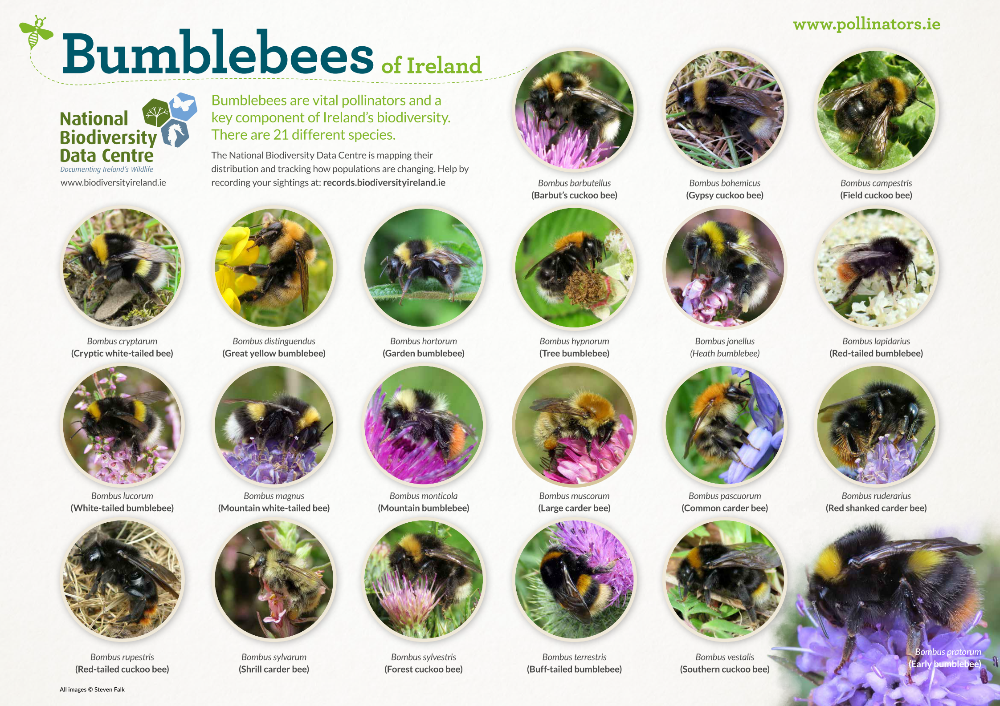

<br> </br>

<h1 style="font-size: 28px; text-align: center; color: green"> 4. Model Evaluation using Local Interpretable Model-agnostic Explanations (LIME) </h1>

<br> </br>

In [1]:
#!pip3 install lime

In [2]:
# Import libraries
import os
import shutil
import random
import xml.etree.ElementTree as ET
import cv2

import warnings
warnings.filterwarnings("ignore")

# Import libraries
import pathlib
import itertools
import glob
import numpy as np

import PIL
from PIL import Image

import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [3]:
test_data_dir = pathlib.Path('/home/hduser/Desktop/final dataset testing/test')

print(test_data_dir)

/home/hduser/Desktop/final dataset testing/test


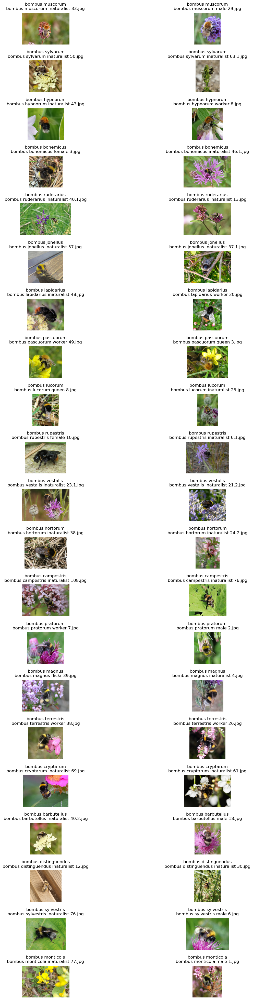

In [4]:
# Get the list of subdirectories (species)
species_list = [subdir.name for subdir in test_data_dir.glob('*')]

# Create a subplot grid
fig, axes = plt.subplots(21, 2, figsize=(15, 50))

# Adjust layout to provide space for titles
plt.subplots_adjust(hspace=0.5)

# Loop through each species
for i, species in enumerate(species_list):
    # Get two images from each species
    species_images = list(test_data_dir.glob(f'{species}/*'))[:2]

    # Loop through each image for the species
    for j, image_path in enumerate(species_images):
        image = Image.open(str(image_path))

        # Extract filename from path
        filename = os.path.basename(image_path)

        # Display the image on the subplot
        axes[i, j].imshow(image)
        axes[i, j].set_title(f'{species}\n{filename}', y=1.02)  # Adjust y position for title
        axes[i, j].axis('off')

plt.show()

<br> </br>
<h1 style="font-size: 28px; text-align: center; color: orange"> 4.1 Keras </h1>
<br> </br>

In [5]:
import tensorflow as tf
from tensorflow import keras

from keras.models import model_from_json
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from sklearn.metrics import accuracy_score, confusion_matrix

import lime
from lime import lime_image
from skimage.segmentation import mark_boundaries
from keras.preprocessing import image
from tensorflow.keras.applications import resnet, vgg19, mobilenet_v3
from tensorflow.keras.applications import inception_v3, efficientnet_v2
from keras.applications.imagenet_utils import decode_predictions
from skimage.io import imread

from functools import partial

2023-12-15 00:31:23.050670: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-12-15 00:31:23.073626: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-15 00:31:23.073653: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-15 00:31:23.074293: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-12-15 00:31:23.078140: I tensorflow/core/platform/cpu_feature_guar

In [6]:
explainer = lime_image.LimeImageExplainer()

<br> </br>
- <h1 style="font-size: 16px"> Create functions for testing and evaluating in Keras. </h1>
<br> </br>

In [7]:
def plot_confusion_matrix_test_keras(model, batches, model_name):
    # Get the number of batches
    num_batches = len(batches)

    # Make predictions for each batch
    predictions = []
    true_labels = []

    for i in range(num_batches):
        # Get a batch of data
        batch_data, batch_labels = batches[i]

        # Make predictions for the batch
        batch_predictions = model.predict(batch_data)
        predictions.extend(np.argmax(batch_predictions, axis=1))
        
        # Extract true labels from the batch
        true_labels.extend(np.argmax(batch_labels, axis=1))

    # Convert lists to numpy arrays
    predicted_labels = np.array(predictions)
    true_labels = np.array(true_labels)

    # Get class names from the data generator
    class_names = list(batches.class_indices.keys())

    # Compute the confusion matrix
    cm = confusion_matrix(true_labels, predicted_labels)

    # Plot the confusion matrix using seaborn
    plt.figure(figsize=(14, 10))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names)

    # Loop to annotate each cell in the heatmap
    for i in range(len(class_names)):
        for j in range(len(class_names)):
            plt.text(j + 0.5, i + 0.5, str(cm[i, j]), ha='center', va='center',
                     bbox=dict(facecolor='white', edgecolor='white', boxstyle='round,pad=0.3'))

    plt.xticks(rotation=45)
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')
    plt.title(f'Confusion Matrix of {model_name} Model on Test Dataset', fontsize=20)
    plt.show()

In [8]:
def transform_img_fn(path_list, model, height, width):
    out = []
    for img_path in path_list:
        img = image.load_img(img_path, target_size=(height, width))
        x = image.img_to_array(img)
        x = np.expand_dims(x, axis=0)
        x = model.preprocess_input(x)
        out.append(x)
    return np.vstack(out)

In [9]:
def print_accuracy_keras(model, test_batches, model_name):
    # Predict on the test batches
    predictions = model.predict(test_batches)

    # Extract class labels
    predicted_classes = np.argmax(predictions, axis=1)

    # Assuming you have the true labels for your test data
    true_labels = test_batches.classes

    # Calculate accuracy
    accuracy = accuracy_score(true_labels, predicted_classes)

    print(f"The overall test accuracy score of {model_name} model:\n {accuracy * 100:.2f}%")

In [10]:
def plot_heatmap_keras(explanation, default_value=0):
    # Select the top class from the explanation
    ind = explanation.top_labels[0]

    # Map each explanation weight to the corresponding superpixel
    dict_heatmap = dict(explanation.local_exp[ind])

    # Create a custom function to handle default value
    def get_with_default(key):
        return dict_heatmap.get(key, default_value)

    # Vectorize the function using np.vectorize
    vectorized_get_with_default = np.vectorize(get_with_default, otypes=[np.float64])
    heatmap = vectorized_get_with_default(explanation.segments)

    # Plot. The visualization makes more sense if a symmetrical colorbar is used.
    plt.imshow(heatmap, cmap='RdYlBu', vmin=-np.max(np.abs(heatmap)), vmax=np.max(np.abs(heatmap)))
    plt.colorbar()
    plt.show()

<br> </br>
## 4.1.1 InceptionV3
<br> </br>

In [11]:
os.chdir('/home/hduser/Desktop/final dataset testing/saved models')

# Load model architecture from JSON
with open("model_inception.json", "r") as json_file:
    loaded_model_json = json_file.read()
model_inceptionv3 = model_from_json(loaded_model_json)

# Load model weights from HDF5
model_inceptionv3.load_weights("model_inception_weights.h5")

2023-12-15 00:31:24.538920: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:129] retrieving CUDA diagnostic information for host: alecfei-linuxlaptop
2023-12-15 00:31:24.538935: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:136] hostname: alecfei-linuxlaptop
2023-12-15 00:31:24.539034: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:159] libcuda reported version is: NOT_FOUND: was unable to find libcuda.so DSO loaded into this program
2023-12-15 00:31:24.539054: I external/local_xla/xla/stream_executor/cuda/cuda_diagnostics.cc:163] kernel reported version is: NOT_FOUND: could not find kernel module information in driver version file contents: "NVRM version: NVIDIA UNIX Open Kernel Module for x86_64  545.23.06  Release Build  (dvs-builder@U16-I3-C17-2-2)  Sun Oct 15 17:35:00 UTC 2023
GCC version:  gcc version 11.4.0 (Ubuntu 11.4.0-1ubuntu1~22.04) 
"


In [12]:
# Specify image size and batch size
img_height_inception, img_width_inception = (299, 299)
batch_size = 32

In [13]:
test_batches_inception = ImageDataGenerator(preprocessing_function=
                                            tf.keras.applications.inception_v3.preprocess_input) \
                    .flow_from_directory(test_data_dir, 
                                         target_size=(img_height_inception, img_width_inception),
                                         batch_size=batch_size, class_mode='categorical', 
                                         shuffle=False)

Found 420 images belonging to 21 classes.


In [14]:
# Assuming you have already created test_batches_inception
class_names = list(test_batches_inception.class_indices.keys())

# Now, class_names is a list containing the class names
print(class_names)

['bombus barbutellus', 'bombus bohemicus', 'bombus campestris', 'bombus cryptarum', 'bombus distinguendus', 'bombus hortorum', 'bombus hypnorum', 'bombus jonellus', 'bombus lapidarius', 'bombus lucorum', 'bombus magnus', 'bombus monticola', 'bombus muscorum', 'bombus pascuorum', 'bombus pratorum', 'bombus ruderarius', 'bombus rupestris', 'bombus sylvarum', 'bombus sylvestris', 'bombus terrestris', 'bombus vestalis']


In [15]:
print_accuracy_keras(model_inceptionv3, test_batches_inception, 'InceptionV3')

14/14 [==============================] - 8s 501ms/step
The overall test accuracy score of InceptionV3 model:
 23.33%


1/1 [==============================] - 1s 1s/step


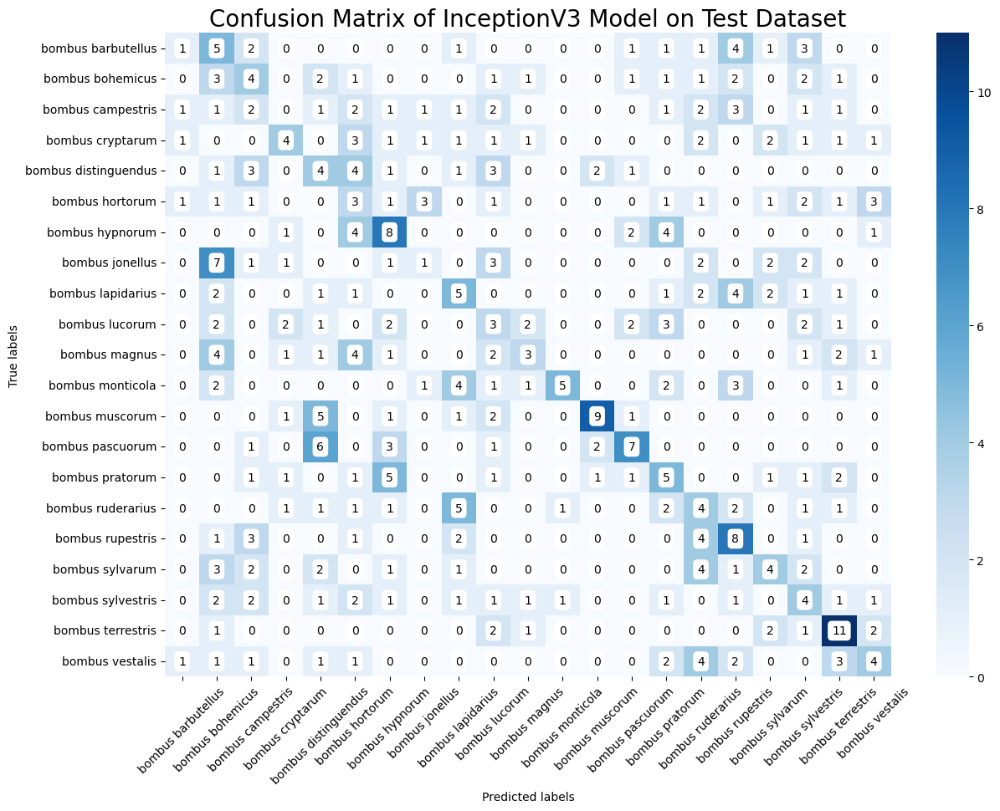

In [16]:
plot_confusion_matrix_test_keras(model_inceptionv3, test_batches_inception, 'InceptionV3')

<br> </br>
<h1 style="font-size: 28px; text-align: center; color: purple"> LIME Evaluation </h1>
<br> </br>

1/1 [==============================] - 0s 65ms/step
Class: bombus rupestris, Confidence: 0.6549780368804932
Class: bombus bohemicus, Confidence: 0.2490817755460739
Class: bombus monticola, Confidence: 0.045152682811021805
Class: bombus cryptarum, Confidence: 0.0360589362680912
Class: bombus sylvestris, Confidence: 0.010692635551095009
Class: bombus ruderarius, Confidence: 0.0018247143598273396
Class: bombus barbutellus, Confidence: 0.0006940033053979278
Class: bombus lapidarius, Confidence: 0.00042312624282203615
Class: bombus sylvarum, Confidence: 0.0004196485097054392
Class: bombus vestalis, Confidence: 0.0003554204886313528
Class: bombus distinguendus, Confidence: 0.0001511462323833257
Class: bombus hortorum, Confidence: 0.0001147233197116293
Class: bombus jonellus, Confidence: 3.796401506406255e-05
Class: bombus campestris, Confidence: 8.102686479105614e-06
Class: bombus magnus, Confidence: 6.2866456573829055e-06
Class: bombus terrestris, Confidence: 3.899711202848266e-07
Class: bo

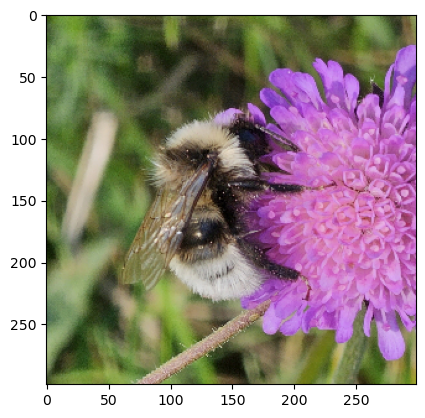

In [17]:
os.chdir(test_data_dir)
barbutellus = transform_img_fn(['./bombus barbutellus/bombus barbutellus inaturalist 15.1.jpg'], 
                               inception_v3, 
                               img_height_inception, 
                               img_width_inception)

plt.imshow(barbutellus[0] / 2 + 0.5)

preds = model_inceptionv3.predict(barbutellus)

# Assuming preds is a 2D array with shape (1, 21)
top_classes = np.argsort(preds[0])[-21:][::-1]  # Get indices of the top 21 predictions

for class_index in top_classes:
    class_label = class_names[class_index]
    confidence = preds[0, class_index]
    print(f"Class: {class_label}, Confidence: {confidence}")

In [18]:
explanation_inception = explainer.explain_instance(barbutellus[0].astype('double'), 
                                                   model_inceptionv3.predict, 
                                                   top_labels=5, 
                                                   hide_color=0, 
                                                   num_samples=1000)

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 200ms/step


<br> </br>
- top 3 superpixels that are most positive towards the class

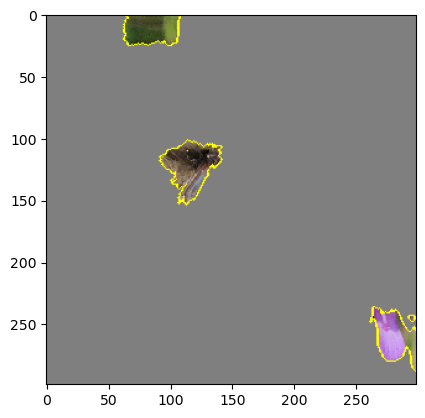

In [19]:
temp, mask = explanation_inception.\
             get_image_and_mask(explanation_inception.top_labels[0], 
                                positive_only=True, 
                                num_features=3, 
                                hide_rest=True)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

In [20]:
# temp, mask = explanation_inception.\
#              get_image_and_mask(explanation_inception.top_labels[0], 
#                                 positive_only=True, 
#                                 num_features=3, 
#                                 hide_rest=False)
# plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

<br> </br>
- pros and cons (pros in green, cons in red)

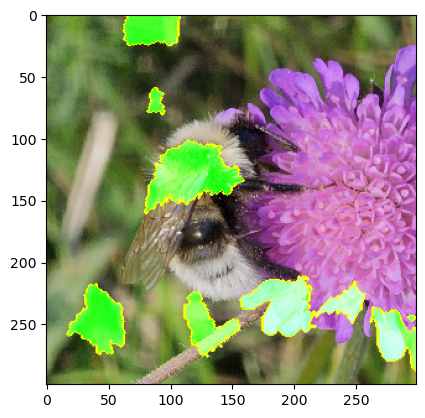

In [21]:
temp, mask = explanation_inception.\
             get_image_and_mask(explanation_inception.top_labels[0], 
                                positive_only=False, 
                                num_features=10, 
                                hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

<br> </br>
- the pros and cons that have weight at least 0.1

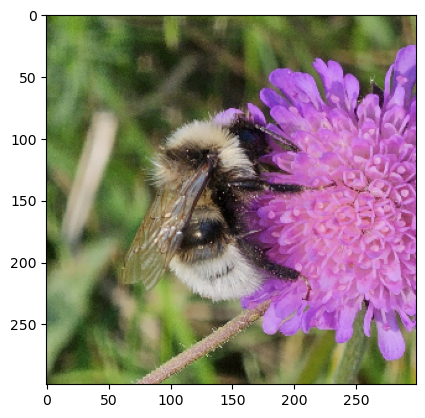

In [22]:
temp, mask = explanation_inception.\
             get_image_and_mask(explanation_inception.top_labels[0], 
                                positive_only=False, 
                                num_features=1000, 
                                hide_rest=False, 
                                min_weight=0.1)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

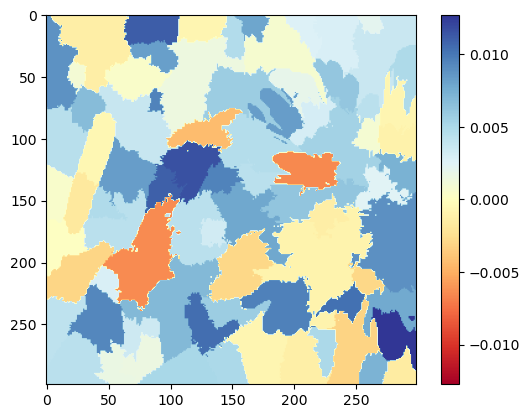

In [23]:
plot_heatmap_keras(explanation_inception)

<br> </br>
## 4.1.2 ResNet101
<br> </br>

In [24]:
os.chdir('/home/hduser/Desktop/final dataset testing/saved models')

# Load model architecture from JSON
with open("model_resnet.json", "r") as json_file:
    loaded_model_json = json_file.read()
model_resnet101 = model_from_json(loaded_model_json)

# Load model weights from HDF5
model_resnet101.load_weights("model_resnet_weights.h5")

In [25]:
# Specify image size and batch size
img_height_resnet, img_width_resnet = (224, 224)
batch_size = 32

In [26]:
test_batches_resnet = ImageDataGenerator(preprocessing_function=
                                         tf.keras.applications.resnet.preprocess_input) \
                    .flow_from_directory(test_data_dir, 
                                         target_size=(img_height_resnet, img_width_resnet),
                                         batch_size=batch_size, class_mode='categorical', 
                                         shuffle=False)

Found 420 images belonging to 21 classes.


In [27]:
# Assuming you have already created test_batches_inception
class_names = list(test_batches_resnet.class_indices.keys())

# Now, class_names is a list containing the class names
print(class_names)

['bombus barbutellus', 'bombus bohemicus', 'bombus campestris', 'bombus cryptarum', 'bombus distinguendus', 'bombus hortorum', 'bombus hypnorum', 'bombus jonellus', 'bombus lapidarius', 'bombus lucorum', 'bombus magnus', 'bombus monticola', 'bombus muscorum', 'bombus pascuorum', 'bombus pratorum', 'bombus ruderarius', 'bombus rupestris', 'bombus sylvarum', 'bombus sylvestris', 'bombus terrestris', 'bombus vestalis']


In [28]:
print_accuracy_keras(model_resnet101, test_batches_resnet, 'ResNet101')

14/14 [==============================] - 15s 932ms/step
The overall test accuracy score of ResNet101 model:
 35.95%


1/1 [==============================] - 2s 2s/step


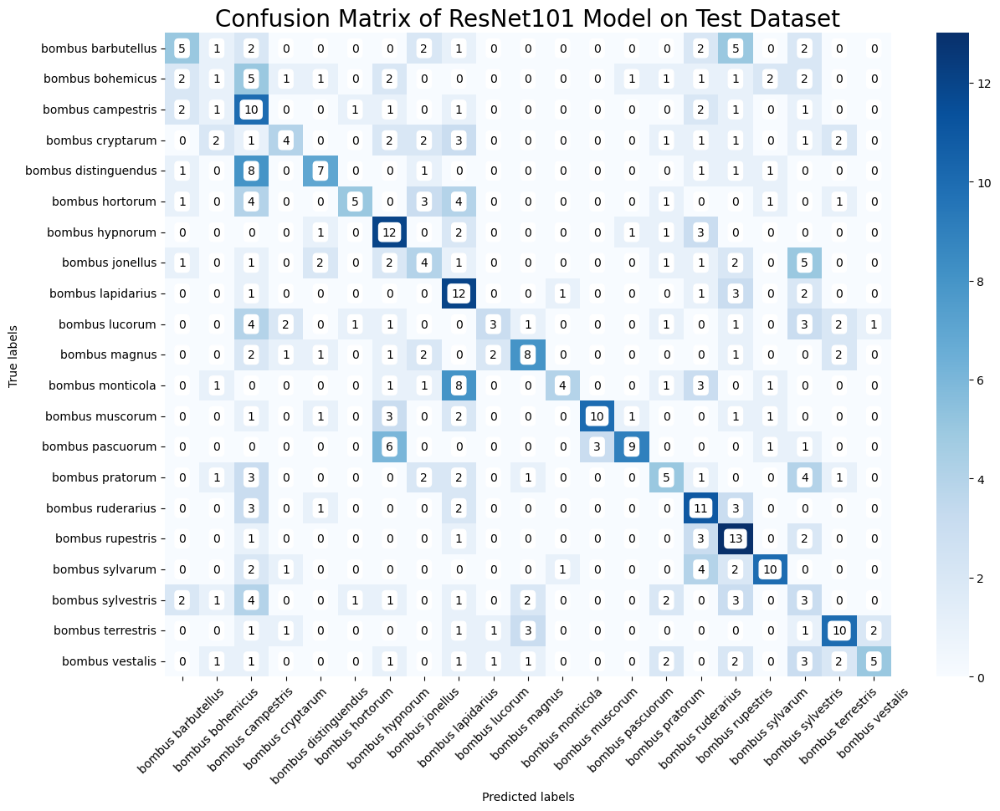

In [29]:
plot_confusion_matrix_test_keras(model_resnet101, test_batches_resnet, 'ResNet101')

<br> </br>
<h1 style="font-size: 28px; text-align: center; color: purple"> LIME Evaluation </h1>
<br> </br>

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 106ms/step
Class: bombus bohemicus, Confidence: 0.626941442489624
Class: bombus barbutellus, Confidence: 0.275351345539093
Class: bombus sylvarum, Confidence: 0.06197720393538475
Class: bombus sylvestris, Confidence: 0.014329150319099426
Class: bombus monticola, Confidence: 0.012589131481945515
Class: bombus jonellus, Confidence: 0.007732801605015993
Class: bombus rupestris, Confidence: 0.0006302417605184019
Class: bombus cryptarum, Confidence: 0.00031946529634296894
Class: bombus hypnorum, Confidence: 5.146368857822381e-05
Class: bombus hortorum, Confidence: 4.9869948270497844e-05
Class: bombus ruderarius, Confidence: 2.209460399171803e-05
Class: bombus campestris, Confidence: 4.2816950553969946e-06
Class: bombus pratorum, Confidence: 5.514359031622007e-07
Class: bombus muscorum, Confidence: 5.050039248999383e-07
Class: bombus magnus, Confidence: 2.5208271381416125e-07
Class: bombus lapidarius, Confidence: 1.0602430933204232e-07
Class: bombus 

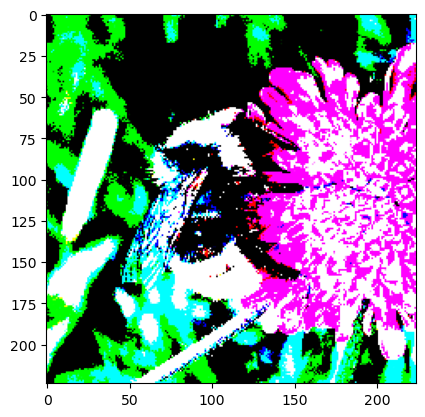

In [30]:
os.chdir(test_data_dir)
barbutellus = transform_img_fn(['./bombus barbutellus/bombus barbutellus inaturalist 15.1.jpg'], 
                               resnet, 
                               img_height_resnet, 
                               img_width_resnet)

plt.imshow(barbutellus[0] / 2 + 0.5)

preds = model_resnet101.predict(barbutellus)

# Assuming preds is a 2D array with shape (1, 21)
top_classes = np.argsort(preds[0])[-21:][::-1]  # Get indices of the top 21 predictions

for class_index in top_classes:
    class_label = class_names[class_index]
    confidence = preds[0, class_index]
    print(f"Class: {class_label}, Confidence: {confidence}")

In [31]:
explanation_resnet = explainer.explain_instance(barbutellus[0].astype('double'), 
                                                model_resnet101.predict, 
                                                top_labels=5, 
                                                hide_color=0, 
                                                num_samples=1000)

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 402ms/step


<br> </br>
- top 3 superpixels that are most positive towards the class

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


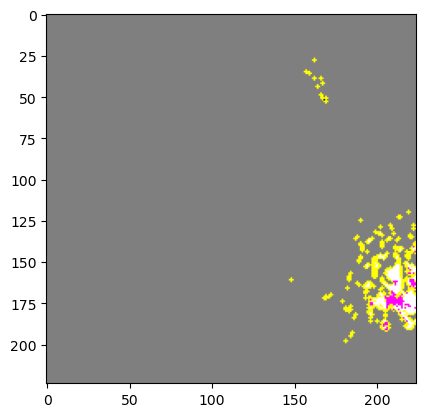

In [32]:
temp, mask = explanation_resnet.\
             get_image_and_mask(explanation_resnet.top_labels[0], 
                                positive_only=True, 
                                num_features=3, 
                                hide_rest=True)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

In [33]:
# temp, mask = explanation_resnet.\
#              get_image_and_mask(explanation_resnet.top_labels[0], 
#                                 positive_only=True, 
#                                 num_features=3, 
#                                 hide_rest=False)
# plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

<br> </br>
- pros and cons (pros in green, cons in red)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


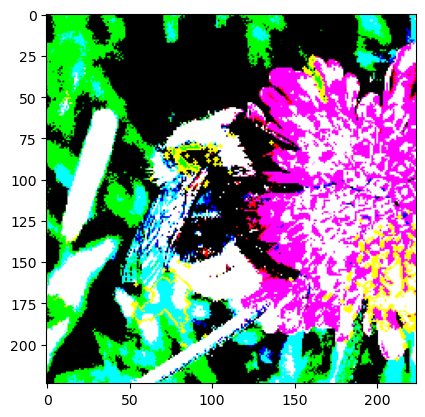

In [34]:
temp, mask = explanation_resnet.\
             get_image_and_mask(explanation_resnet.top_labels[0], 
                                positive_only=False, 
                                num_features=10, 
                                hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

<br> </br>
- the pros and cons that have weight at least 0.1

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


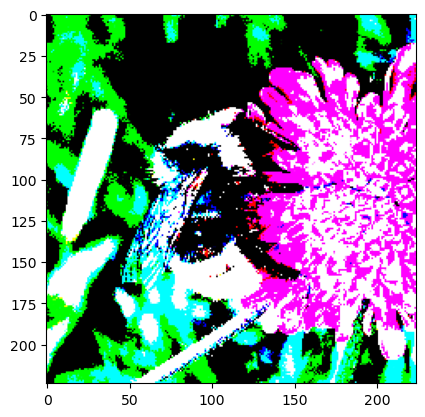

In [35]:
temp, mask = explanation_resnet.\
             get_image_and_mask(explanation_resnet.top_labels[0], 
                                positive_only=False, 
                                num_features=1000, 
                                hide_rest=False, 
                                min_weight=0.1)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

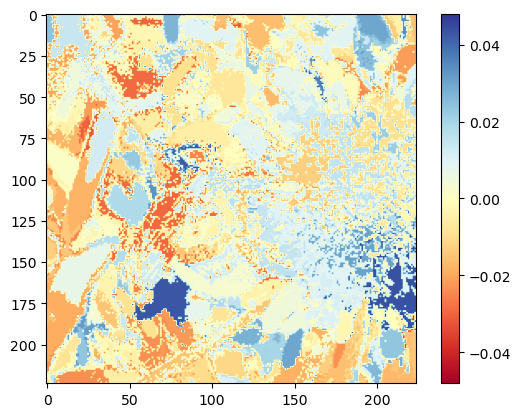

In [36]:
plot_heatmap_keras(explanation_resnet)

<br> </br>

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 72ms/step
Class: bombus ruderarius, Confidence: 0.9957225322723389
Class: bombus rupestris, Confidence: 0.0033487691543996334
Class: bombus vestalis, Confidence: 0.0007988841971382499
Class: bombus lapidarius, Confidence: 8.445108687737957e-05
Class: bombus campestris, Confidence: 3.302298136986792e-05
Class: bombus terrestris, Confidence: 7.431840458593797e-06
Class: bombus sylvestris, Confidence: 3.4701067761488957e-06
Class: bombus hortorum, Confidence: 1.1658638641165453e-06
Class: bombus sylvarum, Confidence: 1.4303445539098902e-07
Class: bombus barbutellus, Confidence: 6.604349778172036e-08
Class: bombus cryptarum, Confidence: 8.534083661970726e-09
Class: bombus pratorum, Confidence: 3.433715534129078e-09
Class: bombus hypnorum, Confidence: 1.214611300426327e-09
Class: bombus pascuorum, Confidence: 1.6200485397632747e-10
Class: bombus bohemicus, Confidence: 3.0657533803268855e-12
Class: bombus jonellus, Confidence: 6.314665587300872e-13
C

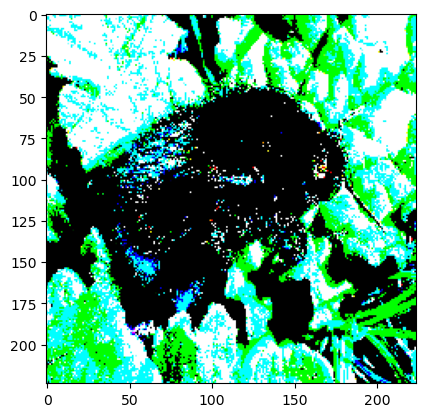

In [37]:
ruderarius = transform_img_fn(['./bombus ruderarius/bombus ruderarius queen 11.jpg'], 
                               resnet, 
                               img_height_resnet, 
                               img_width_resnet)

plt.imshow(ruderarius[0] / 2 + 0.5)

preds = model_resnet101.predict(ruderarius)

# Assuming preds is a 2D array with shape (1, 21)
top_classes = np.argsort(preds[0])[-21:][::-1]  # Get indices of the top 21 predictions

for class_index in top_classes:
    class_label = class_names[class_index]
    confidence = preds[0, class_index]
    print(f"Class: {class_label}, Confidence: {confidence}")

In [38]:
explanation_resnet = explainer.explain_instance(ruderarius[0].astype('double'), 
                                                model_resnet101.predict, 
                                                top_labels=5, 
                                                hide_color=0, 
                                                num_samples=1000)

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 410ms/step


<br> </br>
- top 3 superpixels that are most positive towards the class

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


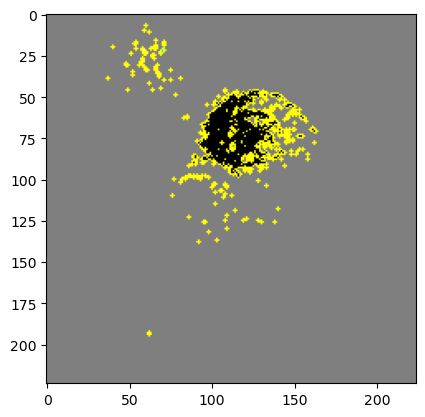

In [39]:
temp, mask = explanation_resnet.\
             get_image_and_mask(explanation_resnet.top_labels[0], 
                                positive_only=True, 
                                num_features=3, 
                                hide_rest=True)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

In [40]:
# temp, mask = explanation_resnet.\
#              get_image_and_mask(explanation_resnet.top_labels[0], 
#                                 positive_only=True, 
#                                 num_features=3, 
#                                 hide_rest=False)
# plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

<br> </br>
- pros and cons (pros in green, cons in red)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


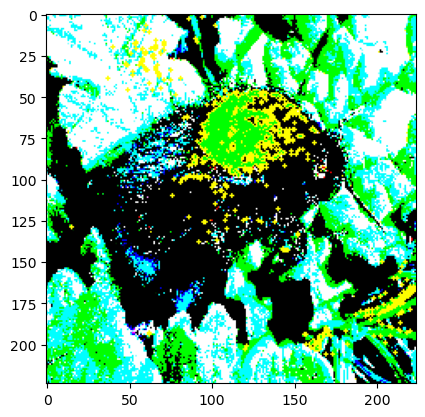

In [41]:
temp, mask = explanation_resnet.\
             get_image_and_mask(explanation_resnet.top_labels[0], 
                                positive_only=False, 
                                num_features=10, 
                                hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

<br> </br>
- the pros and cons that have weight at least 0.1

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


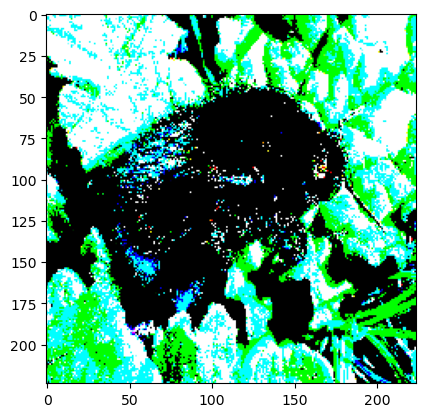

In [42]:
temp, mask = explanation_resnet.\
             get_image_and_mask(explanation_resnet.top_labels[0], 
                                positive_only=False, 
                                num_features=1000, 
                                hide_rest=False, 
                                min_weight=0.1)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

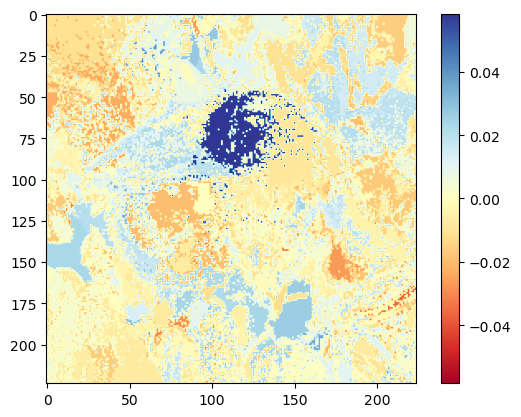

In [43]:
plot_heatmap_keras(explanation_resnet)

<br> </br>
## 4.1.3 VGG19
<br> </br>

In [44]:
os.chdir('/home/hduser/Desktop/final dataset testing/saved models')

# Load model architecture from JSON
with open("model_vgg.json", "r") as json_file:
    loaded_model_json = json_file.read()
model_vgg19 = model_from_json(loaded_model_json)

# Load model weights from HDF5
model_vgg19.load_weights("model_vgg_weights.h5")

In [45]:
# Specify image size and batch size
img_height_vgg, img_width_vgg = (224, 224)
batch_size = 32

In [46]:
test_batches_vgg = ImageDataGenerator(preprocessing_function=
                                      tf.keras.applications.vgg19.preprocess_input) \
                    .flow_from_directory(test_data_dir, 
                                         target_size=(img_height_vgg, img_width_vgg),
                                         batch_size=batch_size, class_mode='categorical', 
                                         shuffle=False)

Found 420 images belonging to 21 classes.


In [47]:
# Assuming you have already created test_batches_inception
class_names = list(test_batches_vgg.class_indices.keys())

# Now, class_names is a list containing the class names
print(class_names)

['bombus barbutellus', 'bombus bohemicus', 'bombus campestris', 'bombus cryptarum', 'bombus distinguendus', 'bombus hortorum', 'bombus hypnorum', 'bombus jonellus', 'bombus lapidarius', 'bombus lucorum', 'bombus magnus', 'bombus monticola', 'bombus muscorum', 'bombus pascuorum', 'bombus pratorum', 'bombus ruderarius', 'bombus rupestris', 'bombus sylvarum', 'bombus sylvestris', 'bombus terrestris', 'bombus vestalis']


In [48]:
print_accuracy_keras(model_vgg19, test_batches_vgg, 'VGG19')

14/14 [==============================] - 25s 2s/step
The overall test accuracy score of VGG19 model:
 26.43%


1/1 [==============================] - 0s 390ms/step


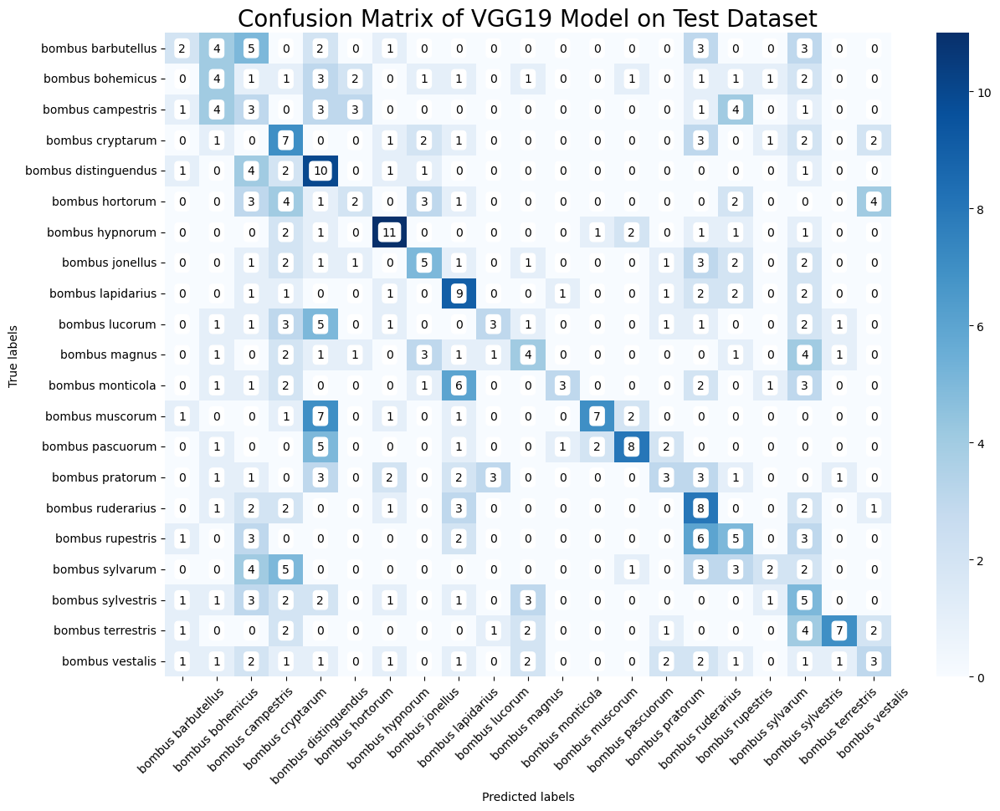

In [49]:
plot_confusion_matrix_test_keras(model_vgg19, test_batches_vgg, 'VGG19')

<br> </br>
<h1 style="font-size: 28px; text-align: center; color: purple"> LIME Evaluation </h1>
<br> </br>

<br> </br>

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 118ms/step
Class: bombus bohemicus, Confidence: 0.9996604919433594
Class: bombus sylvestris, Confidence: 0.00014189905778039247
Class: bombus barbutellus, Confidence: 9.628430416341871e-05
Class: bombus hypnorum, Confidence: 8.630671072751284e-05
Class: bombus ruderarius, Confidence: 1.0086886504723225e-05
Class: bombus sylvarum, Confidence: 3.3881892704812344e-06
Class: bombus monticola, Confidence: 1.5990804058674257e-06
Class: bombus campestris, Confidence: 2.6561428612126292e-08
Class: bombus muscorum, Confidence: 2.1298342645081902e-08
Class: bombus distinguendus, Confidence: 5.7034483802453906e-09
Class: bombus rupestris, Confidence: 3.3696296863894304e-09
Class: bombus cryptarum, Confidence: 2.608744775756122e-09
Class: bombus hortorum, Confidence: 2.3668684789868166e-09
Class: bombus jonellus, Confidence: 1.5755136084649735e-09
Class: bombus lucorum, Confidence: 6.4790806053594e-10
Class: bombus pratorum, Confidence: 3.481508970004654e-

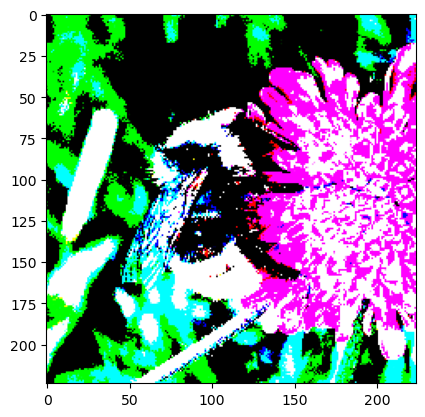

In [50]:
os.chdir(test_data_dir)
barbutellus = transform_img_fn(['./bombus barbutellus/bombus barbutellus inaturalist 15.1.jpg'], 
                               vgg19, 
                               img_height_vgg, 
                               img_width_vgg)

plt.imshow(barbutellus[0] / 2 + 0.5)

preds = model_vgg19.predict(barbutellus)

# Assuming preds is a 2D array with shape (1, 21)
top_classes = np.argsort(preds[0])[-21:][::-1]  # Get indices of the top 21 predictions

for class_index in top_classes:
    class_label = class_names[class_index]
    confidence = preds[0, class_index]
    print(f"Class: {class_label}, Confidence: {confidence}")

In [51]:
explanation_vgg = explainer.explain_instance(barbutellus[0].astype('double'), 
                                             model_vgg19.predict, 
                                             top_labels=5, 
                                             hide_color=0, 
                                             num_samples=1000)

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 1s 627ms/step


<br> </br>
- top 3 superpixels that are most positive towards the class

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


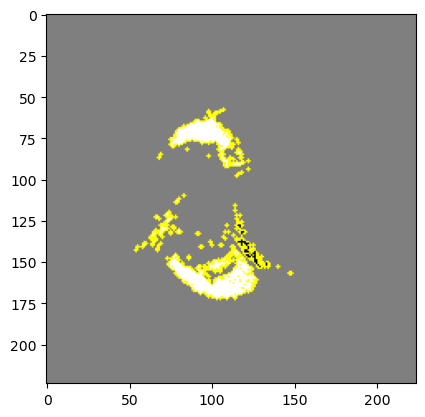

In [52]:
temp, mask = explanation_vgg.\
             get_image_and_mask(explanation_vgg.top_labels[0], 
                                positive_only=True, 
                                num_features=3, 
                                hide_rest=True)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

In [53]:
# temp, mask = explanation_vgg.\
#              get_image_and_mask(explanation_vgg.top_labels[0], 
#                                 positive_only=True, 
#                                 num_features=3, 
#                                 hide_rest=False)
# plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

<br> </br>
- pros and cons (pros in green, cons in red)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


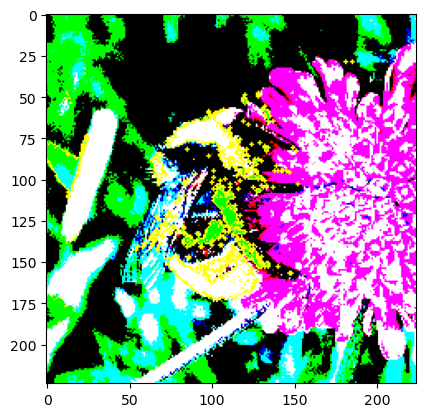

In [54]:
temp, mask = explanation_vgg.\
             get_image_and_mask(explanation_vgg.top_labels[0], 
                                positive_only=False, 
                                num_features=10, 
                                hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

<br> </br>
- the pros and cons that have weight at least 0.1

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


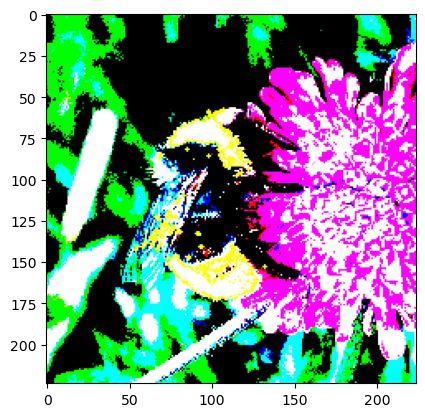

In [55]:
temp, mask = explanation_vgg.\
             get_image_and_mask(explanation_vgg.top_labels[0], 
                                positive_only=False, 
                                num_features=1000, 
                                hide_rest=False, 
                                min_weight=0.1)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

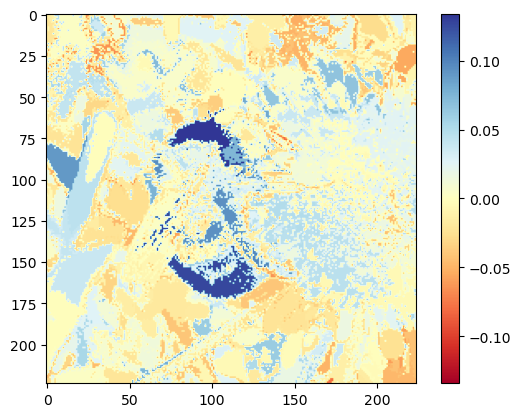

In [56]:
plot_heatmap_keras(explanation_vgg)

<br> </br>
## 4.1.4 MobileNetV3Large
<br> </br>

In [58]:
os.chdir('/home/hduser/Desktop/final dataset testing/saved models')

# Load model architecture from JSON
with open("model_mobilenet.json", "r") as json_file:
    loaded_model_json = json_file.read()
model_mobilenetv3 = model_from_json(loaded_model_json)

# Load model weights from HDF5
model_mobilenetv3.load_weights("model_mobilenet_weights.h5")

In [59]:
# Specify image size and batch size
img_height_mobilenet, img_width_mobilenet = (224, 224)
batch_size = 32

In [60]:
test_batches_mobilenet = ImageDataGenerator(preprocessing_function=
                                            tf.keras.applications.mobilenet_v3.preprocess_input) \
                    .flow_from_directory(test_data_dir, 
                                         target_size=(img_height_mobilenet, img_width_mobilenet),
                                         batch_size=batch_size, class_mode='categorical', 
                                         shuffle=False)

Found 420 images belonging to 21 classes.


In [61]:
# Assuming you have already created test_batches_inception
class_names = list(test_batches_mobilenet.class_indices.keys())

# Now, class_names is a list containing the class names
print(class_names)

['bombus barbutellus', 'bombus bohemicus', 'bombus campestris', 'bombus cryptarum', 'bombus distinguendus', 'bombus hortorum', 'bombus hypnorum', 'bombus jonellus', 'bombus lapidarius', 'bombus lucorum', 'bombus magnus', 'bombus monticola', 'bombus muscorum', 'bombus pascuorum', 'bombus pratorum', 'bombus ruderarius', 'bombus rupestris', 'bombus sylvarum', 'bombus sylvestris', 'bombus terrestris', 'bombus vestalis']


In [62]:
print_accuracy_keras(model_mobilenetv3, test_batches_mobilenet, 'MobileNetV3 Large')

14/14 [==============================] - 5s 320ms/step
The overall test accuracy score of MobileNetV3 Large model:
 40.24%


1/1 [==============================] - 1s 800ms/step


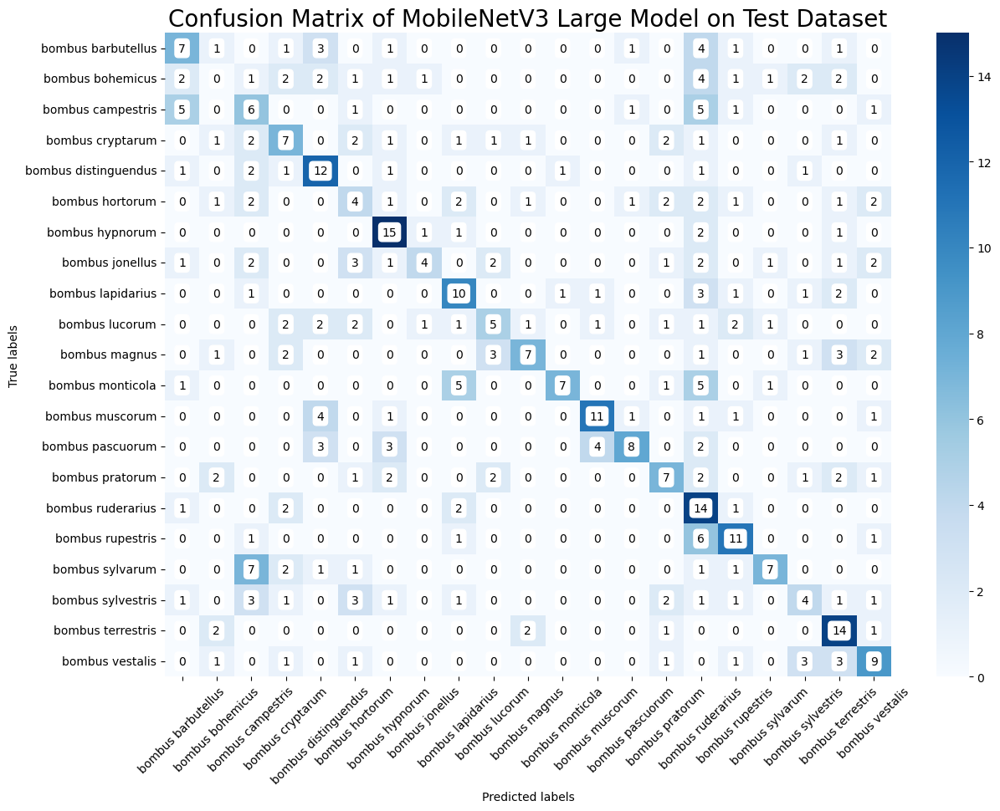

In [63]:
plot_confusion_matrix_test_keras(model_mobilenetv3, test_batches_mobilenet, 'MobileNetV3 Large')

<br> </br>
<h1 style="font-size: 28px; text-align: center; color: purple"> LIME Evaluation </h1>
<br> </br>

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 47ms/step
Class: bombus cryptarum, Confidence: 0.9998599290847778
Class: bombus lucorum, Confidence: 7.056460162857547e-05
Class: bombus jonellus, Confidence: 3.664784162538126e-05
Class: bombus terrestris, Confidence: 2.2538239136338234e-05
Class: bombus bohemicus, Confidence: 6.561027930729324e-06
Class: bombus lapidarius, Confidence: 2.6771699594974052e-06
Class: bombus hortorum, Confidence: 4.795751351593935e-07
Class: bombus magnus, Confidence: 3.2039071129474905e-07
Class: bombus vestalis, Confidence: 1.6002471170395438e-07
Class: bombus ruderarius, Confidence: 4.138166076472771e-08
Class: bombus hypnorum, Confidence: 1.3204215498774374e-08
Class: bombus sylvestris, Confidence: 8.200872869679188e-09
Class: bombus sylvarum, Confidence: 1.234932378579856e-09
Class: bombus pratorum, Confidence: 9.042283588556188e-10
Class: bombus monticola, Confidence: 7.271133781877603e-12
Class: bombus campestris, Confidence: 9.088366994744468e-13
Class: b

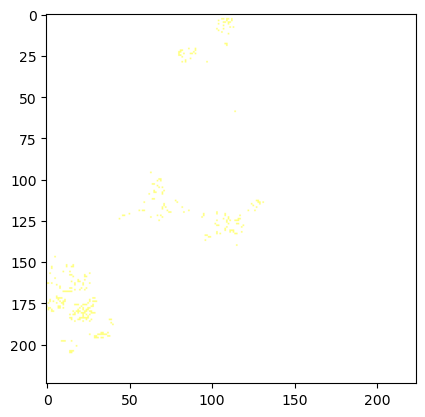

In [64]:
os.chdir(test_data_dir)
cryptarum = transform_img_fn(['./bombus cryptarum/bombus cryptarum inaturalist 83.jpg'],
                             mobilenet_v3, 
                             img_height_mobilenet, 
                             img_width_mobilenet)

plt.imshow(cryptarum[0] / 2 + 0.5)

preds = model_mobilenetv3.predict(cryptarum)

# Assuming preds is a 2D array with shape (1, 21)
top_classes = np.argsort(preds[0])[-21:][::-1]  # Get indices of the top 21 predictions

for class_index in top_classes:
    class_label = class_names[class_index]
    confidence = preds[0, class_index]
    print(f"Class: {class_label}, Confidence: {confidence}")

In [65]:
explanation_mobilenet = explainer.explain_instance(cryptarum[0].astype('double'), 
                                                   model_mobilenetv3.predict, 
                                                   top_labels=5, 
                                                   hide_color=0, 
                                                   num_samples=1000)

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 49ms/step


<br> </br>
- top 3 superpixels that are most positive towards the class

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


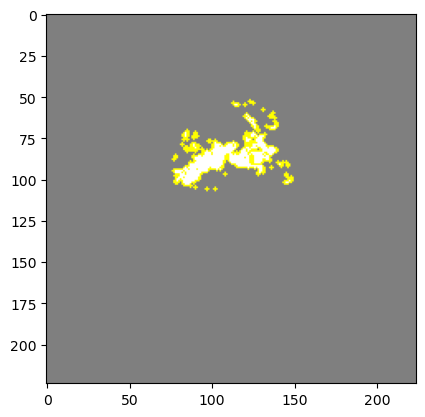

In [66]:
temp, mask = explanation_mobilenet.\
             get_image_and_mask(explanation_mobilenet.top_labels[0], 
                                positive_only=True, 
                                num_features=3, 
                                hide_rest=True)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

In [67]:
# temp, mask = explanation_mobilenet.\
#              get_image_and_mask(explanation_mobilenet.top_labels[0], 
#                                 positive_only=True, 
#                                 num_features=3, 
#                                 hide_rest=False)
# plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

<br> </br>
- pros and cons (pros in green, cons in red)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


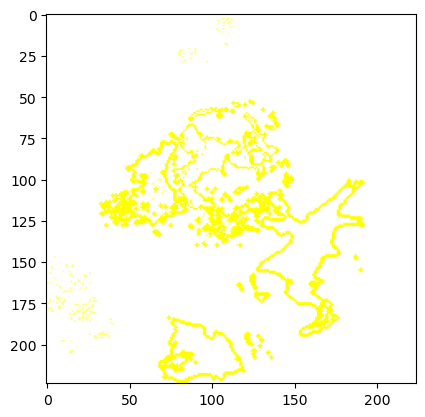

In [68]:
temp, mask = explanation_mobilenet.\
             get_image_and_mask(explanation_mobilenet.top_labels[0], 
                                positive_only=False, 
                                num_features=10, 
                                hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

<br> </br>
- the pros and cons that have weight at least 0.1

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


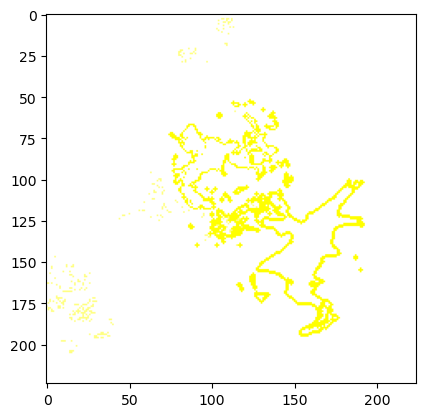

In [69]:
temp, mask = explanation_mobilenet.\
             get_image_and_mask(explanation_mobilenet.top_labels[0], 
                                positive_only=False, 
                                num_features=1000, 
                                hide_rest=False, 
                                min_weight=0.1)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

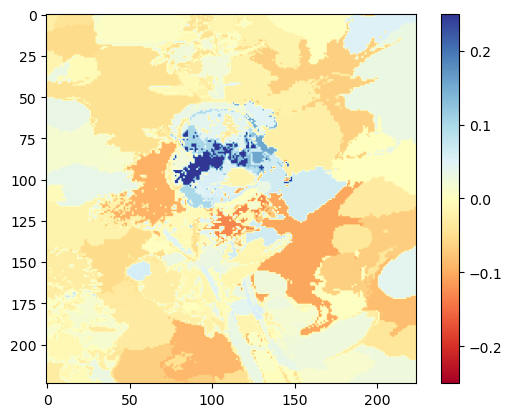

In [70]:
plot_heatmap_keras(explanation_mobilenet)

<br> </br>
## 4.1.5 EfficientNetV2 Medium
<br> </br>

In [71]:
os.chdir('/home/hduser/Desktop/final dataset testing/saved models')

# Load model architecture from JSON
with open("model_efficientnet.json", "r") as json_file:
    loaded_model_json = json_file.read()
model_efficientnetv2 = model_from_json(loaded_model_json)

# Load model weights from HDF5
model_efficientnetv2.load_weights("model_efficientnet_weights.h5")

In [72]:
# Specify image size and batch size
img_height_efficientnet, img_width_efficientnet = (224, 224)
batch_size = 32

In [73]:
test_batches_efficientnet = ImageDataGenerator(preprocessing_function=
                                               tf.keras.applications.efficientnet_v2.preprocess_input) \
                    .flow_from_directory(test_data_dir, 
                                         target_size=(img_height_efficientnet, img_width_efficientnet),
                                         batch_size=batch_size, class_mode='categorical', 
                                         shuffle=False)

Found 420 images belonging to 21 classes.


In [74]:
# Assuming you have already created test_batches_inception
class_names = list(test_batches_efficientnet.class_indices.keys())

# Now, class_names is a list containing the class names
print(class_names)

['bombus barbutellus', 'bombus bohemicus', 'bombus campestris', 'bombus cryptarum', 'bombus distinguendus', 'bombus hortorum', 'bombus hypnorum', 'bombus jonellus', 'bombus lapidarius', 'bombus lucorum', 'bombus magnus', 'bombus monticola', 'bombus muscorum', 'bombus pascuorum', 'bombus pratorum', 'bombus ruderarius', 'bombus rupestris', 'bombus sylvarum', 'bombus sylvestris', 'bombus terrestris', 'bombus vestalis']


In [75]:
print_accuracy_keras(model_efficientnetv2, test_batches_efficientnet, 'EfficientNetV2_Medium')

14/14 [==============================] - 15s 798ms/step
The overall test accuracy score of EfficientNetV2_Medium model:
 38.10%


1/1 [==============================] - 4s 4s/step


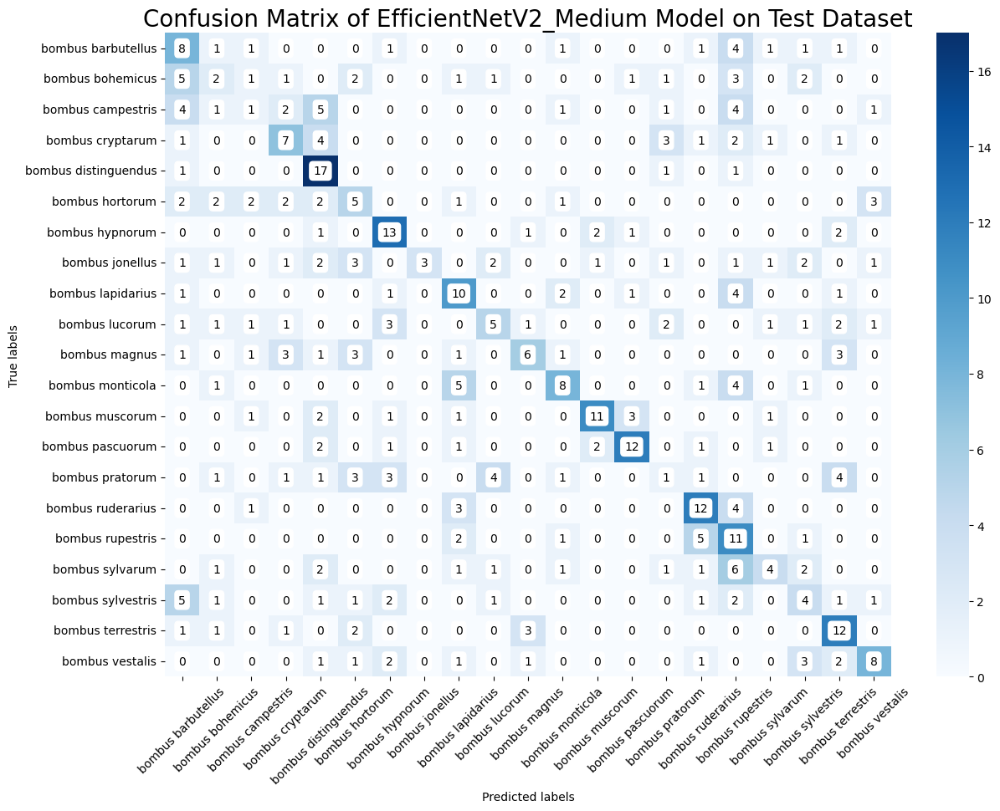

In [76]:
plot_confusion_matrix_test_keras(model_efficientnetv2, test_batches_efficientnet, 'EfficientNetV2_Medium')

<br> </br>
<h1 style="font-size: 28px; text-align: center; color: purple"> LIME Evaluation </h1>
<br> </br>

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 100ms/step
Class: bombus cryptarum, Confidence: 0.6161395907402039
Class: bombus sylvarum, Confidence: 0.36222028732299805
Class: bombus bohemicus, Confidence: 0.012752952054142952
Class: bombus ruderarius, Confidence: 0.0028442100156098604
Class: bombus jonellus, Confidence: 0.002753643086180091
Class: bombus monticola, Confidence: 0.0012820445699617267
Class: bombus sylvestris, Confidence: 0.0010871023405343294
Class: bombus hortorum, Confidence: 0.0004083148087374866
Class: bombus barbutellus, Confidence: 0.000283758039586246
Class: bombus lucorum, Confidence: 0.00010183770064031705
Class: bombus lapidarius, Confidence: 5.664193304255605e-05
Class: bombus magnus, Confidence: 2.325391506019514e-05
Class: bombus rupestris, Confidence: 1.8733864635578357e-05
Class: bombus distinguendus, Confidence: 1.7530541299493052e-05
Class: bombus pratorum, Confidence: 7.502858807129087e-06
Class: bombus hypnorum, Confidence: 1.0825016261151177e-06
Class: b

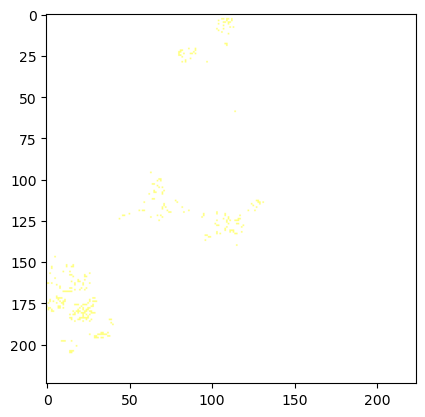

In [77]:
os.chdir(test_data_dir)
cryptarum = transform_img_fn(['./bombus cryptarum/bombus cryptarum inaturalist 83.jpg'],
                             efficientnet_v2, 
                             img_height_efficientnet, 
                             img_width_efficientnet)

plt.imshow(cryptarum[0] / 2 + 0.5)

preds = model_efficientnetv2.predict(cryptarum)

# Assuming preds is a 2D array with shape (1, 21)
top_classes = np.argsort(preds[0])[-21:][::-1]  # Get indices of the top 21 predictions

for class_index in top_classes:
    class_label = class_names[class_index]
    confidence = preds[0, class_index]
    print(f"Class: {class_label}, Confidence: {confidence}")

In [78]:
explanation_efficientnet = explainer.explain_instance(cryptarum[0].astype('double'), 
                                                      model_efficientnetv2.predict, 
                                                      top_labels=5, 
                                                      hide_color=0, 
                                                      num_samples=1000)

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 311ms/step


<br> </br>
- top 3 superpixels that are most positive towards the class

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


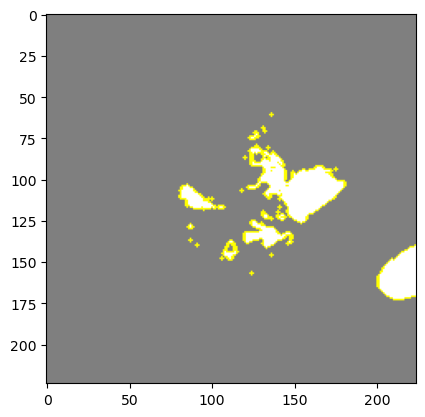

In [79]:
temp, mask = explanation_efficientnet.\
             get_image_and_mask(explanation_efficientnet.top_labels[0], 
                                positive_only=True, 
                                num_features=3, 
                                hide_rest=True)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

In [80]:
# temp, mask = explanation_efficientnet.\
#              get_image_and_mask(explanation_efficientnet.top_labels[0], 
#                                 positive_only=True, 
#                                 num_features=3, 
#                                 hide_rest=False)
# plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

<br> </br>
- pros and cons (pros in green, cons in red)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


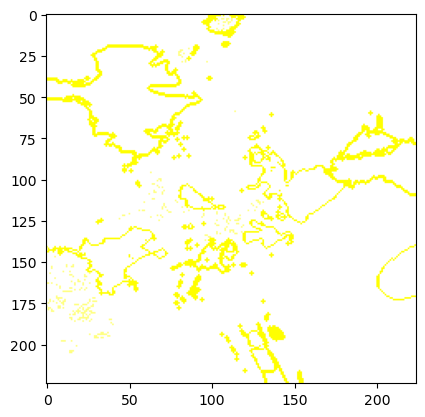

In [81]:
temp, mask = explanation_efficientnet.\
             get_image_and_mask(explanation_efficientnet.top_labels[0], 
                                positive_only=False, 
                                num_features=10, 
                                hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

<br> </br>
- the pros and cons that have weight at least 0.1

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


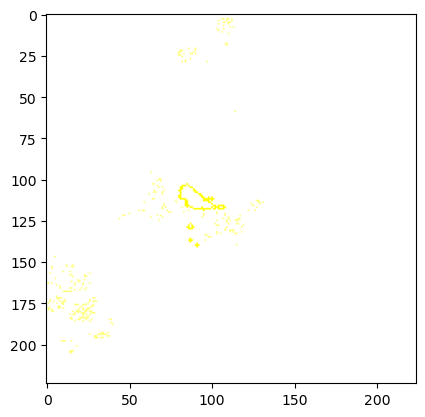

In [82]:
temp, mask = explanation_efficientnet.\
             get_image_and_mask(explanation_efficientnet.top_labels[0], 
                                positive_only=False, 
                                num_features=1000, 
                                hide_rest=False, 
                                min_weight=0.1)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

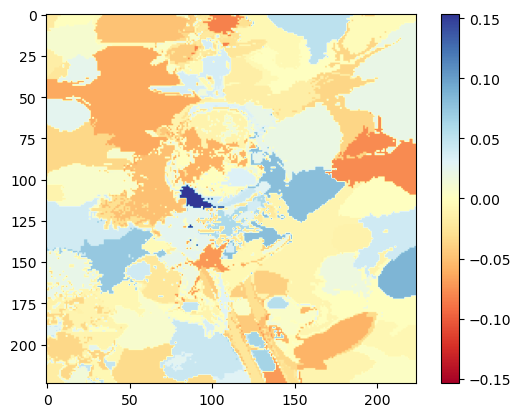

In [83]:
plot_heatmap_keras(explanation_efficientnet)

<br> </br>

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1/1 [==============================] - 0s 118ms/step
Class: bombus hypnorum, Confidence: 0.6428523659706116
Class: bombus pascuorum, Confidence: 0.3013361990451813
Class: bombus monticola, Confidence: 0.02439568005502224
Class: bombus muscorum, Confidence: 0.012041295878589153
Class: bombus rupestris, Confidence: 0.00805136002600193
Class: bombus pratorum, Confidence: 0.005912399850785732
Class: bombus lapidarius, Confidence: 0.0016525378450751305
Class: bombus bohemicus, Confidence: 0.0014212335227057338
Class: bombus vestalis, Confidence: 0.0008379423525184393
Class: bombus barbutellus, Confidence: 0.0006626981194131076
Class: bombus sylvestris, Confidence: 0.00046412250958383083
Class: bombus terrestris, Confidence: 0.00026458484353497624
Class: bombus hortorum, Confidence: 5.758294355473481e-05
Class: bombus distinguendus, Confidence: 2.0614899767679162e-05
Class: bombus jonellus, Confidence: 1.624352989892941e-05
Class: bombus magnus, Confidence: 9.4011602413957e-06
Class: bombus 

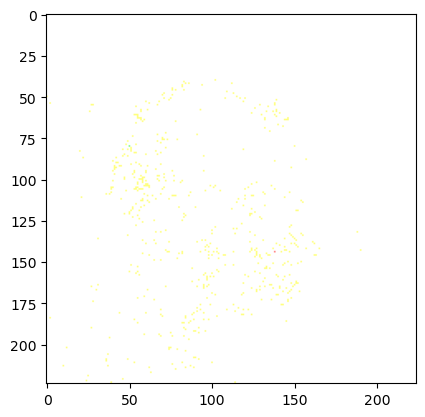

In [203]:
pascuorum = transform_img_fn(['./bombus pascuorum/bombus pascuorum queen 40.jpg'],
                             efficientnet_v2, 
                             img_height_efficientnet, 
                             img_width_efficientnet)

plt.imshow(pascuorum[0] / 2 + 0.5)

preds = model_efficientnetv2.predict(pascuorum)

# Assuming preds is a 2D array with shape (1, 21)
top_classes = np.argsort(preds[0])[-21:][::-1]  # Get indices of the top 21 predictions

for class_index in top_classes:
    class_label = class_names[class_index]
    confidence = preds[0, class_index]
    print(f"Class: {class_label}, Confidence: {confidence}")

In [204]:
explanation_efficientnet = explainer.explain_instance(pascuorum[0].astype('double'), 
                                                      model_efficientnetv2.predict, 
                                                      top_labels=5, 
                                                      hide_color=0, 
                                                      num_samples=1000)

  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 321ms/step


<br> </br>
- top 3 superpixels that are most positive towards the class

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


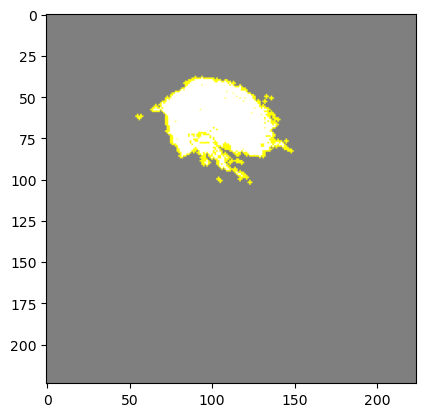

In [205]:
temp, mask = explanation_efficientnet.\
             get_image_and_mask(explanation_efficientnet.top_labels[0], 
                                positive_only=True, 
                                num_features=3, 
                                hide_rest=True)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

In [206]:
# temp, mask = explanation_efficientnet.\
#              get_image_and_mask(explanation_efficientnet.top_labels[0], 
#                                 positive_only=True, 
#                                 num_features=3, 
#                                 hide_rest=False)
# plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

<br> </br>
- pros and cons (pros in green, cons in red)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


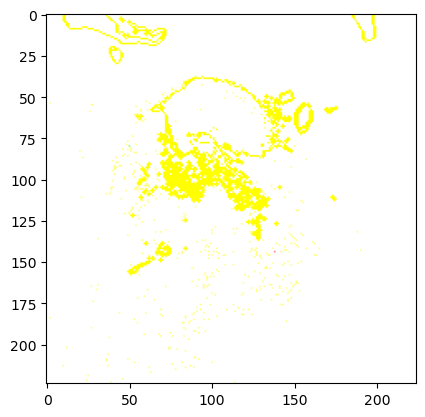

In [207]:
temp, mask = explanation_efficientnet.\
             get_image_and_mask(explanation_efficientnet.top_labels[0], 
                                positive_only=False, 
                                num_features=10, 
                                hide_rest=False)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

<br> </br>
- the pros and cons that have weight at least 0.1

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


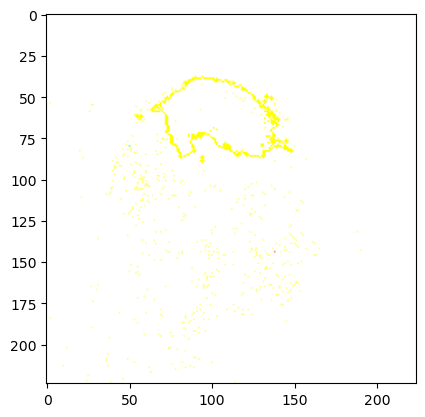

In [208]:
temp, mask = explanation_efficientnet.\
             get_image_and_mask(explanation_efficientnet.top_labels[0], 
                                positive_only=False, 
                                num_features=1000, 
                                hide_rest=False, 
                                min_weight=0.1)
plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

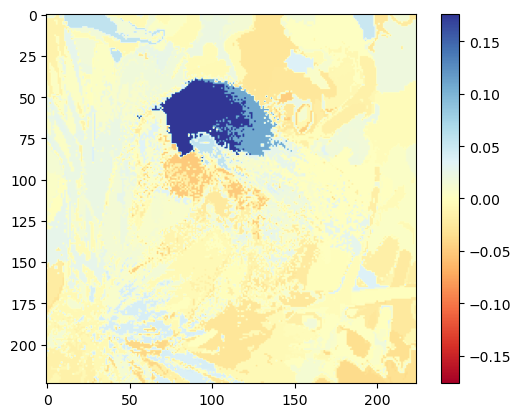

In [209]:
plot_heatmap_keras(explanation_efficientnet)

<br> </br>
<h1 style="font-size: 28px; text-align: center; color: orange"> 4.2 Pytorch </h1>
<br> </br>

In [84]:
import torch
import torch.nn as nn

import torchvision
from torchvision import datasets, models, transforms
import torchvision.models as models
from torch.utils.data import DataLoader, Dataset

import json

from torch.autograd import Variable
import torch.nn.functional as F

<br> </br>
- <h1 style="font-size: 16px"> Create functions for testing and evaluating in Pytorch. </h1>
<br> </br>

In [85]:
def plot_images(dataset, title):
    # Create a DataLoader for the dataset
    loader = DataLoader(dataset, batch_size=8, shuffle=True)
    
    # Retrieve a batch of images and labels
    images, labels = next(iter(loader))

    # Plotting code
    fig, axes = plt.subplots(1, 5, figsize=(25, 5))
    axes = axes.flatten()

    for i in range(5):
        im = images[i].cpu().numpy().transpose((1, 2, 0))
        axes[i].imshow(im)
        axes[i].set_title(dataset.classes[labels[i]], size=10)
        axes[i].axis('off')

    fig.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.show()

In [86]:
def pytorch_predict(model, test_image_name):
    '''
    Function to predict the class of a single test image
    Parameters
        :param model: Model to test
        :param test_image_name: Test image

    '''
    
    transform = data_transform['test']


    test_image = PIL.Image.open(test_image_name)
    plt.imshow(test_image)
    
    test_image_tensor = transform(test_image)

    if torch.cuda.is_available():
        test_image_tensor = test_image_tensor.view(1, 3, 224, 224).cuda()
    else:
        test_image_tensor = test_image_tensor.view(1, 3, 224, 224)
    
    with torch.no_grad():
        model.eval()
        # Model outputs log probabilities
        out = model(test_image_tensor)
        ps = torch.exp(out)
        topk, topclass = ps.topk(8, dim=1)
        for i in range(8):
            print("Predcition", i+1, ":", class_names[topclass.numpy()[0][i]], ", Score: ", topk.numpy()[0][i])

In [87]:
def print_accuracy_pytorch(model, data_loader, model_name):
    device = torch.device("cpu")
    model.to(device)
    
    correct_predictions = 0
    total_samples = 0
    
    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, predictions = torch.max(outputs, 1)

            correct_predictions += (predictions == labels).sum().item()
            total_samples += labels.size(0)

    accuracy = correct_predictions / total_samples
    print(f'The overall test accuracy score of {model_name} model:\n {accuracy * 100:.2f}%')

In [88]:
def plot_confusion_matrix_test_pytorch(model, data_loader, model_name):
    device = torch.device("cpu")
    model.to(device)

    all_predictions = []
    all_labels = []

    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, predictions = torch.max(outputs, 1)

            all_predictions.extend(predictions.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())

    # Calculate the confusion matrix
    cm = confusion_matrix(all_labels, all_predictions)
    class_names = test_dataset.classes
    
    plt.figure(figsize=(14, 10))
    sns.heatmap(cm, annot=False, fmt='d', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names)

    # Loop to annotate each cell in the heatmap
    for i in range(len(class_names)):
        for j in range(len(class_names)):
            plt.text(j + 0.5, i + 0.5, str(cm[i, j]), ha='center', va='center',
                     bbox=dict(facecolor='white', edgecolor='white', boxstyle='round,pad=0.3'))

    plt.xticks(rotation=45)
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')
    plt.title(f'Confusion Matrix of {model_name} on Test Dataset', fontsize=20)
    plt.show()

In [89]:
# Function for loading images
def get_image(path):
    with open(os.path.abspath(path), 'rb') as f:
        with PIL.Image.open(f) as img:
            return img.convert('RGB')


# Function for transforming images to standard
def get_input_transform():
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                    std=[0.229, 0.224, 0.225])       
    transf = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        normalize
    ])    

    return transf

def get_input_tensors(img):
    transf = get_input_transform()
    # unsqeeze converts single image to batch of 1
    return transf(img).unsqueeze(0)


# Function for getting preditions
def get_pil_transform(): 
    transf = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.CenterCrop(224)
    ])    

    return transf

def get_preprocess_transform():
    normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                    std=[0.229, 0.224, 0.225])     
    transf = transforms.Compose([
        transforms.ToTensor(),
        normalize
    ])    

    return transf    

image_transform = get_pil_transform()
preprocess_transform = get_preprocess_transform()

In [90]:
def visualize_explanation_pytorch(explanation, default_value=0):
    """
    Visualize the explanation using a heatmap.

    Parameters:
    - explanation: LimeTabularExplainer explanation object
    - default_value: Default value for None entries in the heatmap

    Returns:
    None (Displays the heatmap using matplotlib)
    """
    # Select the same class explained on the figures above.
    ind = explanation.top_labels[0]

    # Map each explanation weight to the corresponding superpixel
    dict_heatmap = dict(explanation.local_exp[ind])

    # Create a custom function to handle default value
    def get_with_default(key):
        return dict_heatmap.get(key, default_value)

    # Vectorize the function using np.vectorize
    vectorized_get_with_default = np.vectorize(get_with_default, otypes=[np.float64])
    heatmap = vectorized_get_with_default(explanation.segments)

    # Plot. The visualization makes more sense if a symmetrical colorbar is used.
    plt.imshow(heatmap, cmap='RdYlBu', vmin=-np.max(np.abs(heatmap)), vmax=np.max(np.abs(heatmap)))
    plt.colorbar()
    plt.show()

<br> </br>
- **Load test data**

In [91]:
input_size= 224

data_transform = { 
    'test': transforms.Compose([
            transforms.Resize(input_size),
            transforms.CenterCrop(input_size),
            transforms.ToTensor(),
            transforms.Normalize([0.485, 0.456, 0.406],
                             [0.229, 0.224, 0.225])
    ])
}

In [92]:
# Load test dataset
test_dataset = datasets.ImageFolder(root=test_data_dir, 
                                    transform=data_transform['test'])

In [93]:
test_data_size = len(test_dataset)

print(test_data_size)

420


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


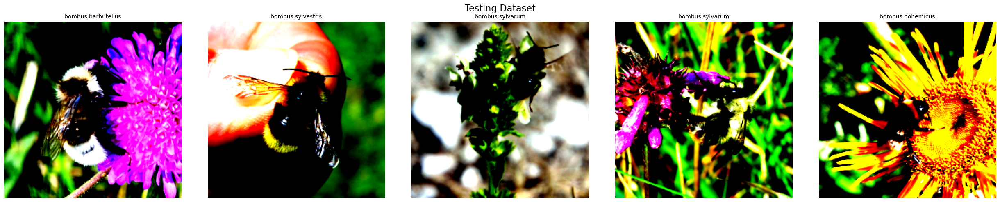

In [94]:
plot_images(test_dataset, 'Testing Dataset')

In [95]:
batch_size=32
num_workers=4

In [96]:
test_loader = DataLoader(test_dataset, batch_size=batch_size,
                         shuffle=False, num_workers=num_workers)

In [97]:
# Number of classes
num_classes = len(os.listdir(test_data_dir))
print(num_classes)

21


In [98]:
class_names = test_dataset.classes

<br> </br>
## 4.2.1 SqueezeNet
<br> </br>

In [99]:
os.chdir('/home/hduser/Desktop/final dataset testing/saved models')
# Create an instance of the SqueezeNet model
model_squeezenet = models.squeezenet1_1(weights='DEFAULT')
model_squeezenet.classifier[0] = nn.Dropout(p=0.4, inplace=False)
model_squeezenet.classifier[1] = nn.Conv2d(512, num_classes, kernel_size=(1,1), stride=(1,1))

# Load the saved model weights
model_squeezenet.load_state_dict(torch.load("model_squeezenet.pth"))

# Set the model to evaluation mode
model_squeezenet.eval()

SqueezeNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
    (3): Fire(
      (squeeze): Conv2d(64, 16, kernel_size=(1, 1), stride=(1, 1))
      (squeeze_activation): ReLU(inplace=True)
      (expand1x1): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
      (expand1x1_activation): ReLU(inplace=True)
      (expand3x3): Conv2d(16, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (expand3x3_activation): ReLU(inplace=True)
    )
    (4): Fire(
      (squeeze): Conv2d(128, 16, kernel_size=(1, 1), stride=(1, 1))
      (squeeze_activation): ReLU(inplace=True)
      (expand1x1): Conv2d(16, 64, kernel_size=(1, 1), stride=(1, 1))
      (expand1x1_activation): ReLU(inplace=True)
      (expand3x3): Conv2d(16, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (expand3x3_activation): ReLU(inplace=True)
    )
    (5): MaxPool2d

In [100]:
print_accuracy_pytorch(model_squeezenet, test_loader, 'SqueezeNet1_1')

The overall test accuracy score of SqueezeNet1_1 model:
 36.43%


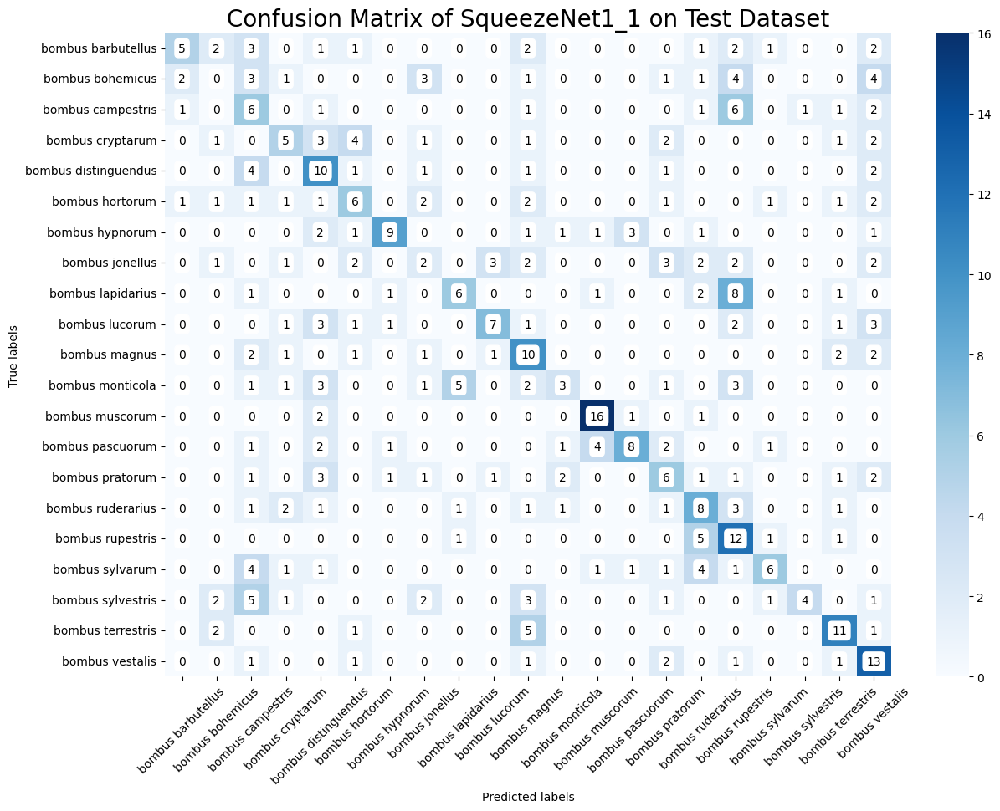

In [101]:
plot_confusion_matrix_test_pytorch(model_squeezenet, test_loader, 'SqueezeNet1_1')

<br> </br>
<h1 style="font-size: 28px; text-align: center; color: purple"> LIME Evaluation </h1>
<br> </br>

In [102]:
os.chdir(test_data_dir)

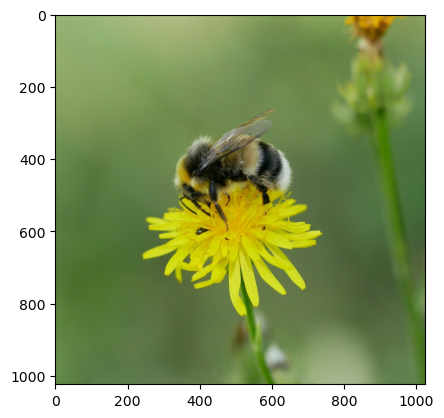

In [103]:
lucorum = get_image('./bombus lucorum/bombus lucorum inaturalist 13.jpg')
plt.imshow(lucorum)

In [104]:
print(class_names)

['bombus barbutellus', 'bombus bohemicus', 'bombus campestris', 'bombus cryptarum', 'bombus distinguendus', 'bombus hortorum', 'bombus hypnorum', 'bombus jonellus', 'bombus lapidarius', 'bombus lucorum', 'bombus magnus', 'bombus monticola', 'bombus muscorum', 'bombus pascuorum', 'bombus pratorum', 'bombus ruderarius', 'bombus rupestris', 'bombus sylvarum', 'bombus sylvestris', 'bombus terrestris', 'bombus vestalis']


Predcition 1 : bombus distinguendus , Score:  17997.152
Predcition 2 : bombus jonellus , Score:  3514.806
Predcition 3 : bombus bohemicus , Score:  2955.9666
Predcition 4 : bombus hortorum , Score:  1796.8444
Predcition 5 : bombus lucorum , Score:  1638.5101
Predcition 6 : bombus campestris , Score:  973.25183
Predcition 7 : bombus vestalis , Score:  386.08536
Predcition 8 : bombus pratorum , Score:  251.52985


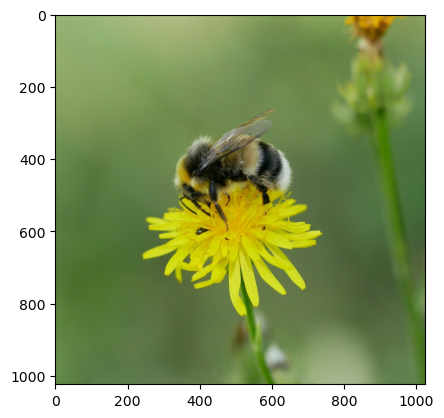

In [105]:
pytorch_predict(model_squeezenet, './bombus lucorum/bombus lucorum inaturalist 13.jpg')

In [106]:
lucorum_tensor = get_input_tensors(lucorum)
model_squeezenet.eval()
logits = model_squeezenet(lucorum_tensor)

In [107]:
print(logits)

tensor([[4.8412, 7.4833, 6.5965, 7.2917, 8.0736, 5.9654, 4.5532, 8.0355, 2.1958,
         7.9807, 4.4199, 3.2705, 3.1479, 1.3654, 4.4207, 3.3612, 5.0172, 3.3833,
         6.0380, 3.0069, 5.2644]], grad_fn=<ViewBackward0>)


In [108]:
probs = F.softmax(logits, dim=1)
probs5 = probs.topk(5)
tuple((p,c, class_names[c]) for p, c in zip(probs5[0][0].detach().numpy(), probs5[1][0].detach().numpy()))

((0.21560408, 4, 'bombus distinguendus'),
 (0.20754503, 7, 'bombus jonellus'),
 (0.19648394, 9, 'bombus lucorum'),
 (0.11947971, 1, 'bombus bohemicus'),
 (0.09865009, 3, 'bombus cryptarum'))

In [109]:
def batch_predict_squeezenet(images):
    model_squeezenet.eval()
    batch = torch.stack(tuple(preprocess_transform(i) for i in images), dim=0)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model_squeezenet.to(device)
    batch = batch.to(device)
    
    logits = model_squeezenet(batch)
    probs = F.softmax(logits, dim=1)
    return probs.detach().cpu().numpy()

In [110]:
test_pred_squeezenet = batch_predict_squeezenet([image_transform(lucorum)])
class_label = test_pred_squeezenet.squeeze().argmax()
print(f'The top one predicted class label is {class_label}.')
print(f'The top one predicted class name is: {class_names[class_label]}.')

The top one predicted class label is 4.
The top one predicted class name is: bombus distinguendus.


In [111]:
explanation_squeezenet = explainer.explain_instance(np.array(image_transform(lucorum)), 
                                                    batch_predict_squeezenet,
                                                    top_labels=5, 
                                                    hide_color=0, 
                                                    num_samples=1000)

  0%|          | 0/1000 [00:00<?, ?it/s]

<br> </br>
- top 3 superpixels that are most positive towards the class

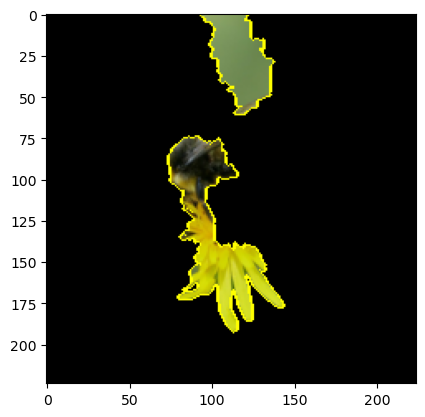

In [112]:
temp, mask = explanation_squeezenet.\
             get_image_and_mask(explanation_squeezenet.top_labels[0], 
                                positive_only=True, 
                                num_features=3, 
                                hide_rest=True)
plt.imshow(mark_boundaries(temp / 255.0, mask))

In [113]:
# temp, mask = explanation_squeezenet.\
#              get_image_and_mask(explanation_squeezenet.top_labels[0], 
#                                 positive_only=True, 
#                                 num_features=3, 
#                                 hide_rest=False)
# plt.imshow(mark_boundaries(temp / 255.0, mask))

<br> </br>
- pros and cons (pros in green, cons in red)

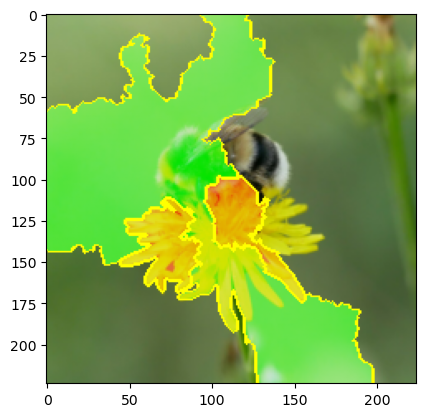

In [114]:
temp, mask = explanation_squeezenet.\
             get_image_and_mask(explanation_squeezenet.top_labels[0], 
                                positive_only=False, 
                                num_features=10, 
                                hide_rest=False)
plt.imshow(mark_boundaries(temp / 255.0, mask))

<br> </br>
- the pros and cons that have weight at least 0.1

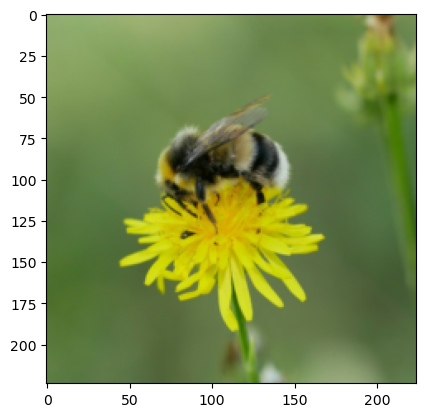

In [115]:
temp, mask = explanation_squeezenet.\
             get_image_and_mask(explanation_squeezenet.top_labels[0], 
                                positive_only=False, 
                                num_features=1000, 
                                hide_rest=False, 
                                min_weight=0.1)
plt.imshow(mark_boundaries(temp / 255.0, mask))

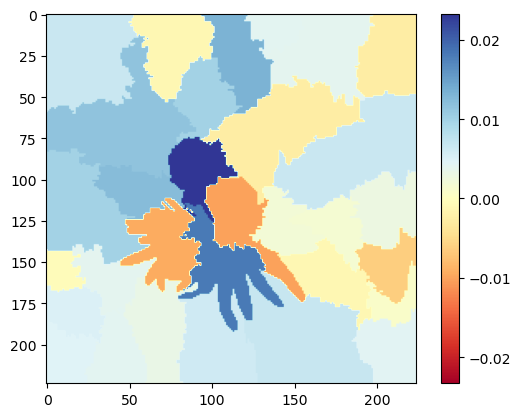

In [116]:
visualize_explanation_pytorch(explanation_squeezenet)

<br> </br>
## 4.2.2 DenseNet121
<br> </br>

In [117]:
os.chdir('/home/hduser/Desktop/final dataset testing/saved models')
# Create an instance of the DenseNet model
model_densenet = models.densenet121(weights='DEFAULT')
model_densenet.avgpool = nn.AdaptiveAvgPool2d(output_size=(1, 1))
model_densenet.classifier = nn.Sequential(
            nn.Dropout(p=0.4, inplace=False),
            nn.Linear(in_features=1024, out_features=21, bias=True)
        )

# Load the saved model weights
model_densenet.load_state_dict(torch.load("model_densenet.pth"))

# Set the model to evaluation mode
model_densenet.eval()

DenseNet(
  (features): Sequential(
    (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu0): ReLU(inplace=True)
    (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (denseblock1): _DenseBlock(
      (denselayer1): _DenseLayer(
        (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu1): ReLU(inplace=True)
        (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu2): ReLU(inplace=True)
        (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      )
      (denselayer2): _DenseLayer(
        (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu

In [118]:
print_accuracy_pytorch(model_densenet, test_loader, 'DenseNet121')

The overall test accuracy score of DenseNet121 model:
 45.24%


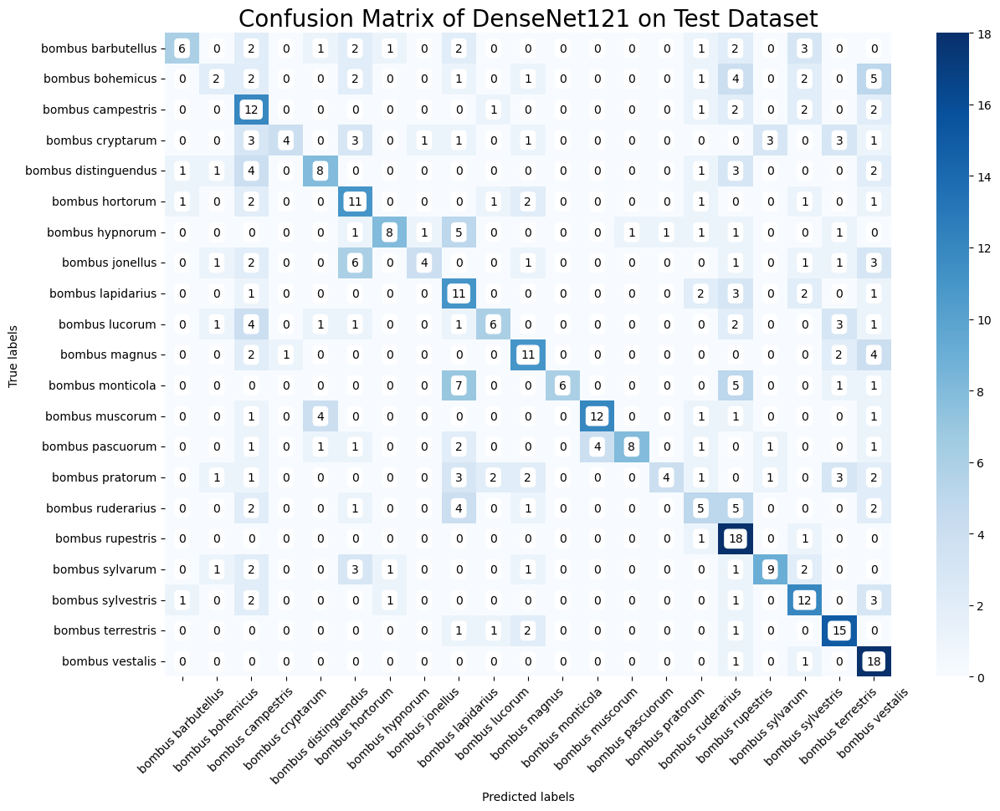

In [119]:
plot_confusion_matrix_test_pytorch(model_densenet, test_loader, 'DenseNet121')

<br> </br>
<h1 style="font-size: 28px; text-align: center; color: purple"> LIME Evaluation </h1>
<br> </br>

In [120]:
os.chdir(test_data_dir)

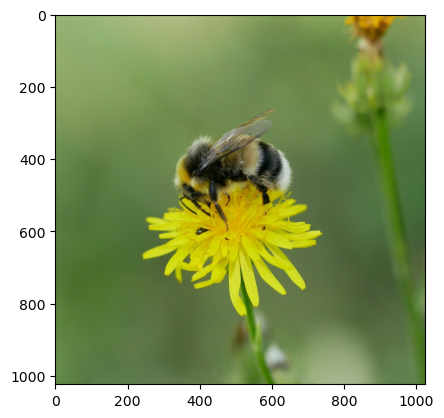

In [121]:
lucorum = get_image('./bombus lucorum/bombus lucorum inaturalist 13.jpg')
plt.imshow(lucorum)

Predcition 1 : bombus bohemicus , Score:  1.1559737
Predcition 2 : bombus lapidarius , Score:  0.21382692
Predcition 3 : bombus magnus , Score:  0.20816849
Predcition 4 : bombus distinguendus , Score:  0.2080543
Predcition 5 : bombus campestris , Score:  0.16603053
Predcition 6 : bombus lucorum , Score:  0.14489852
Predcition 7 : bombus cryptarum , Score:  0.11854934
Predcition 8 : bombus pratorum , Score:  0.10784859


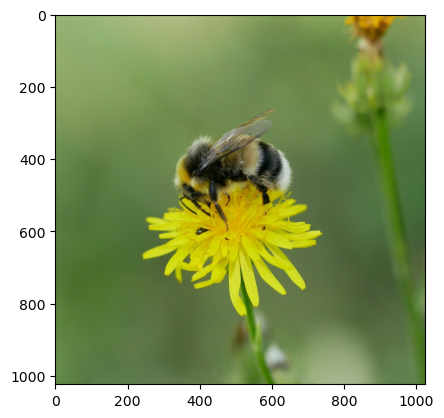

In [122]:
pytorch_predict(model_densenet, './bombus lucorum/bombus lucorum inaturalist 13.jpg')

In [123]:
print(class_names)

['bombus barbutellus', 'bombus bohemicus', 'bombus campestris', 'bombus cryptarum', 'bombus distinguendus', 'bombus hortorum', 'bombus hypnorum', 'bombus jonellus', 'bombus lapidarius', 'bombus lucorum', 'bombus magnus', 'bombus monticola', 'bombus muscorum', 'bombus pascuorum', 'bombus pratorum', 'bombus ruderarius', 'bombus rupestris', 'bombus sylvarum', 'bombus sylvestris', 'bombus terrestris', 'bombus vestalis']


In [124]:
lucorum_tensor = get_input_tensors(lucorum)
model_densenet.eval()
logits = model_densenet(lucorum_tensor)

In [125]:
print(logits)

tensor([[-4.2206,  0.9519, -2.3493, -2.4056, -2.3733, -3.2033, -4.4882, -2.9047,
         -0.9312, -2.4801, -2.2874, -6.4408, -5.4585, -5.4661, -4.5631, -5.4128,
         -2.5793, -6.1883, -1.0841, -3.6076, -2.0022]],
       grad_fn=<AddmmBackward0>)


In [126]:
probs = F.softmax(logits, dim=1)
probs5 = probs.topk(5)
tuple((p,c, class_names[c]) for p, c in zip(probs5[0][0].detach().numpy(), probs5[1][0].detach().numpy()))

((0.62077314, 1, 'bombus bohemicus'),
 (0.09442606, 8, 'bombus lapidarius'),
 (0.08103434, 18, 'bombus sylvestris'),
 (0.032356147, 20, 'bombus vestalis'),
 (0.024326662, 10, 'bombus magnus'))

In [127]:
def batch_predict_densenet(images):
    model_densenet.eval()
    batch = torch.stack(tuple(preprocess_transform(i) for i in images), dim=0)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model_densenet.to(device)
    batch = batch.to(device)
    
    logits = model_densenet(batch)
    probs = F.softmax(logits, dim=1)
    return probs.detach().cpu().numpy()

In [128]:
test_pred_densenet = batch_predict_densenet([image_transform(lucorum)])
class_label = test_pred_densenet.squeeze().argmax()
print(f'The top one predicted class label is {class_label}.')
print(f'The top one predicted class name is: {class_names[class_label]}.')

The top one predicted class label is 1.
The top one predicted class name is: bombus bohemicus.


In [129]:
explanation_densenet = explainer.explain_instance(np.array(image_transform(lucorum)), 
                                                  batch_predict_densenet,
                                                  top_labels=5, 
                                                  hide_color=0, 
                                                  num_samples=1000)

  0%|          | 0/1000 [00:00<?, ?it/s]

<br> </br>
- top 3 superpixels that are most positive towards the class

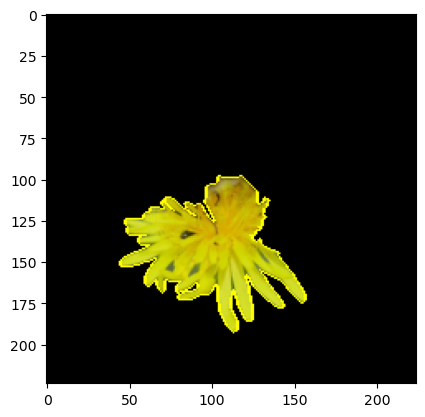

In [130]:
temp, mask = explanation_densenet.\
             get_image_and_mask(explanation_densenet.top_labels[0], 
                                positive_only=True, 
                                num_features=3, 
                                hide_rest=True)
plt.imshow(mark_boundaries(temp / 255.0, mask))

In [131]:
# temp, mask = explanation_densenet.\
#              get_image_and_mask(explanation_densenet.top_labels[0], 
#                                 positive_only=True, 
#                                 num_features=3, 
#                                 hide_rest=False)
# plt.imshow(mark_boundaries(temp / 255.0, mask))

<br> </br>
- pros and cons (pros in green, cons in red)

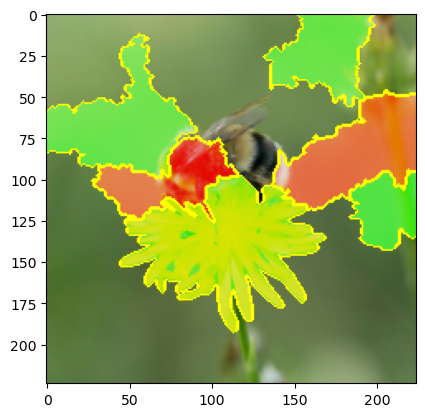

In [132]:
temp, mask = explanation_densenet.\
             get_image_and_mask(explanation_densenet.top_labels[0], 
                                positive_only=False, 
                                num_features=10, 
                                hide_rest=False)
plt.imshow(mark_boundaries(temp / 255.0, mask))

<br> </br>
- the pros and cons that have weight at least 0.1

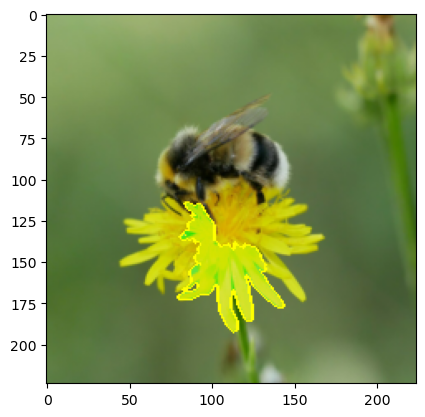

In [133]:
temp, mask = explanation_densenet.\
             get_image_and_mask(explanation_densenet.top_labels[0], 
                                positive_only=False, 
                                num_features=1000, 
                                hide_rest=False, 
                                min_weight=0.1)
plt.imshow(mark_boundaries(temp / 255.0, mask))

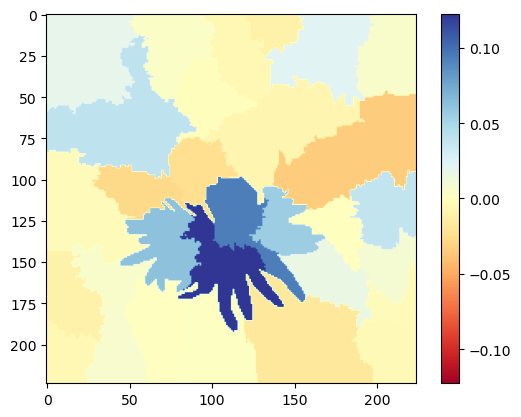

In [134]:
visualize_explanation_pytorch(explanation_densenet)

<br> </br>

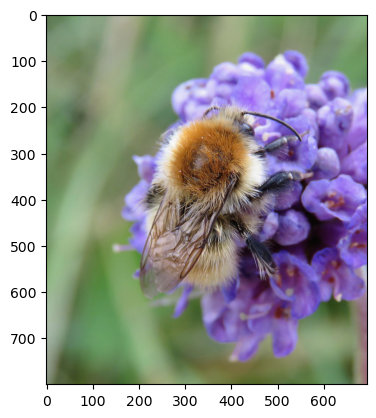

In [135]:
muscorum = get_image('./bombus muscorum/bombus muscorum male 29.jpg')
plt.imshow(muscorum)

Predcition 1 : bombus muscorum , Score:  3826.0747
Predcition 2 : bombus lapidarius , Score:  0.40606683
Predcition 3 : bombus rupestris , Score:  0.10950257
Predcition 4 : bombus vestalis , Score:  0.014874286
Predcition 5 : bombus distinguendus , Score:  0.009944028
Predcition 6 : bombus pascuorum , Score:  0.0021931592
Predcition 7 : bombus pratorum , Score:  0.0016235773
Predcition 8 : bombus hypnorum , Score:  0.00079403585


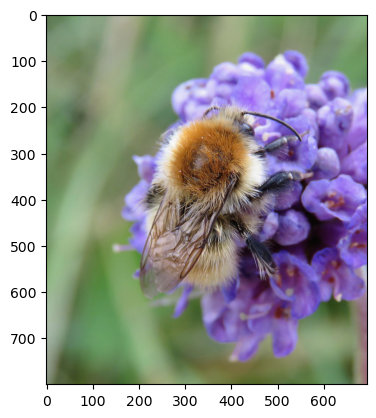

In [136]:
pytorch_predict(model_densenet, './bombus muscorum/bombus muscorum male 29.jpg')

In [137]:
print(class_names)

['bombus barbutellus', 'bombus bohemicus', 'bombus campestris', 'bombus cryptarum', 'bombus distinguendus', 'bombus hortorum', 'bombus hypnorum', 'bombus jonellus', 'bombus lapidarius', 'bombus lucorum', 'bombus magnus', 'bombus monticola', 'bombus muscorum', 'bombus pascuorum', 'bombus pratorum', 'bombus ruderarius', 'bombus rupestris', 'bombus sylvarum', 'bombus sylvestris', 'bombus terrestris', 'bombus vestalis']


In [138]:
muscorum_tensor = get_input_tensors(muscorum)
model_densenet.eval()
logits = model_densenet(muscorum_tensor)

In [139]:
print(logits)

tensor([[-12.4156, -11.3819, -14.1487, -14.1195,  -5.0912, -15.5364,  -6.2085,
         -16.3315,  -0.6879,  -8.9849, -11.8060,  -6.8510,   9.3944,  -4.5219,
          -6.0158,  -7.3101,  -2.0235, -11.1436, -10.6690, -10.2350,  -5.1644]],
       grad_fn=<AddmmBackward0>)


In [140]:
probs = F.softmax(logits, dim=1)
probs5 = probs.topk(5)
tuple((p,c, class_names[c]) for p, c in zip(probs5[0][0].detach().numpy(), probs5[1][0].detach().numpy()))

((0.9999448, 12, 'bombus muscorum'),
 (4.181158e-05, 8, 'bombus lapidarius'),
 (1.0996303e-05, 16, 'bombus rupestris'),
 (9.0404e-07, 13, 'bombus pascuorum'),
 (5.116177e-07, 4, 'bombus distinguendus'))

In [141]:
def batch_predict_densenet(images):
    model_densenet.eval()
    batch = torch.stack(tuple(preprocess_transform(i) for i in images), dim=0)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model_densenet.to(device)
    batch = batch.to(device)
    
    logits = model_densenet(batch)
    probs = F.softmax(logits, dim=1)
    return probs.detach().cpu().numpy()

In [142]:
test_pred_densenet = batch_predict_densenet([image_transform(muscorum)])
class_label = test_pred_densenet.squeeze().argmax()
print(f'The top one predicted class label is {class_label}.')
print(f'The top one predicted class name is: {class_names[class_label]}.')

The top one predicted class label is 12.
The top one predicted class name is: bombus muscorum.


In [143]:
explanation_densenet = explainer.explain_instance(np.array(image_transform(muscorum)), 
                                                  batch_predict_densenet,
                                                  top_labels=5, 
                                                  hide_color=0, 
                                                  num_samples=1000)

  0%|          | 0/1000 [00:00<?, ?it/s]

<br> </br>
- top 3 superpixels that are most positive towards the class

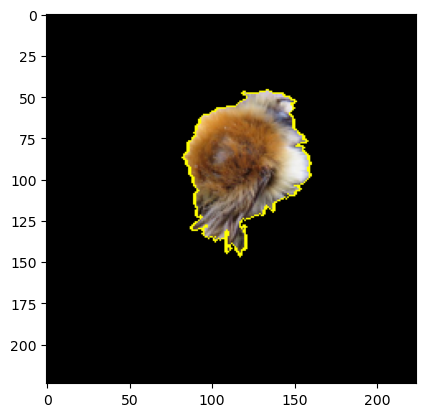

In [144]:
temp, mask = explanation_densenet.\
             get_image_and_mask(explanation_densenet.top_labels[0], 
                                positive_only=True, 
                                num_features=3, 
                                hide_rest=True)
plt.imshow(mark_boundaries(temp / 255.0, mask))

In [145]:
# temp, mask = explanation_densenet.\
#              get_image_and_mask(explanation_densenet.top_labels[0], 
#                                 positive_only=True, 
#                                 num_features=3, 
#                                 hide_rest=False)
# plt.imshow(mark_boundaries(temp / 255.0, mask))

<br> </br>
- pros and cons (pros in green, cons in red)

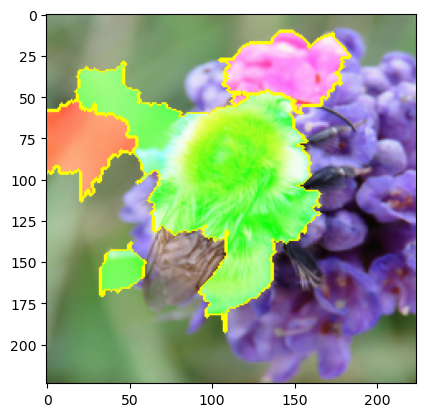

In [146]:
temp, mask = explanation_densenet.\
             get_image_and_mask(explanation_densenet.top_labels[0], 
                                positive_only=False, 
                                num_features=10, 
                                hide_rest=False)
plt.imshow(mark_boundaries(temp / 255.0, mask))

<br> </br>
- the pros and cons that have weight at least 0.1

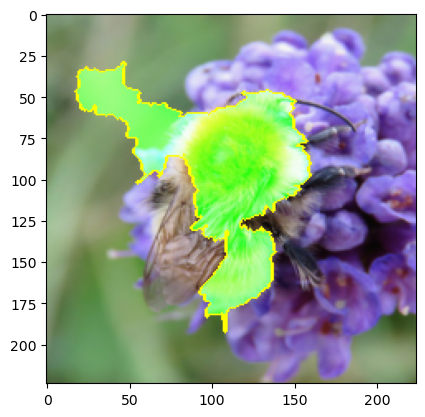

In [147]:
temp, mask = explanation_densenet.\
             get_image_and_mask(explanation_densenet.top_labels[0], 
                                positive_only=False, 
                                num_features=1000, 
                                hide_rest=False, 
                                min_weight=0.1)
plt.imshow(mark_boundaries(temp / 255.0, mask))

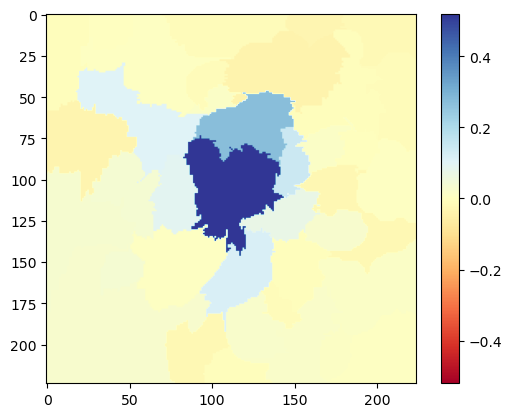

In [148]:
visualize_explanation_pytorch(explanation_densenet)

<br> </br>
## 4.2.3 ShuffleNetV2
<br> </br>

In [149]:
os.chdir('/home/hduser/Desktop/final dataset testing/saved models')
# Create an instance of the ShuffleNet model
model_shufflenet = models.shufflenet_v2_x2_0(weights='DEFAULT')
model_shufflenet.avgpool = nn.AdaptiveAvgPool2d(output_size=(1, 1))
model_shufflenet.classifier = nn.Sequential(
            nn.Dropout(p=0.4, inplace=False),
            nn.Linear(in_features=2048, out_features=21, bias=True)
        )

# Load the saved model weights
model_shufflenet.load_state_dict(torch.load("model_shufflenet.pth"))

# Set the model to evaluation mode
model_shufflenet.eval()

ShuffleNetV2(
  (conv1): Sequential(
    (0): Conv2d(3, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (stage2): Sequential(
    (0): InvertedResidual(
      (branch1): Sequential(
        (0): Conv2d(24, 24, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), groups=24, bias=False)
        (1): BatchNorm2d(24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): Conv2d(24, 122, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (3): BatchNorm2d(122, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (4): ReLU(inplace=True)
      )
      (branch2): Sequential(
        (0): Conv2d(24, 122, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (1): BatchNorm2d(122, eps=1e-05, momentum=0.1, affine=True, track_runn

In [150]:
print_accuracy_pytorch(model_shufflenet, test_loader, 'ShuffleNetV2')

The overall test accuracy score of ShuffleNetV2 model:
 49.76%


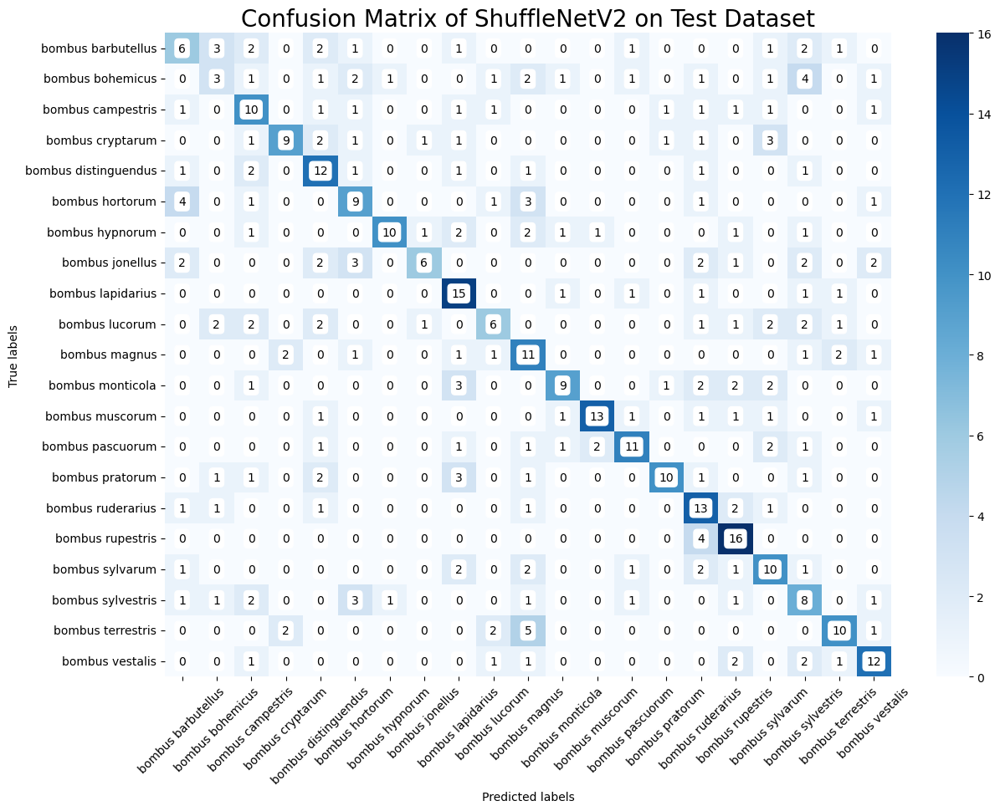

In [151]:
plot_confusion_matrix_test_pytorch(model_shufflenet, test_loader, 'ShuffleNetV2')

<br> </br>
<h1 style="font-size: 28px; text-align: center; color: purple"> LIME Evaluation </h1>
<br> </br>

In [152]:
os.chdir(test_data_dir)

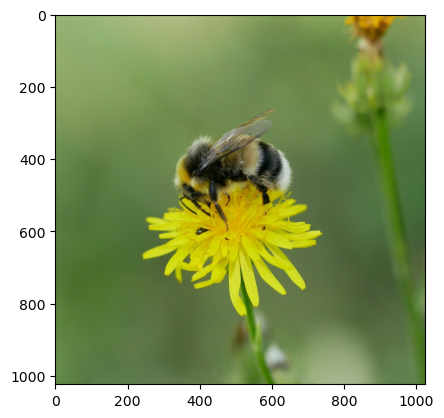

In [153]:
lucorum = get_image('./bombus lucorum/bombus lucorum inaturalist 13.jpg')
plt.imshow(lucorum)

Predcition 1 : bombus bohemicus , Score:  81.947266
Predcition 2 : bombus distinguendus , Score:  28.107105
Predcition 3 : bombus sylvestris , Score:  5.404637
Predcition 4 : bombus pratorum , Score:  2.8173118
Predcition 5 : bombus sylvarum , Score:  0.78885865
Predcition 6 : bombus campestris , Score:  0.7058673
Predcition 7 : bombus cryptarum , Score:  0.6354555
Predcition 8 : bombus muscorum , Score:  0.5427334


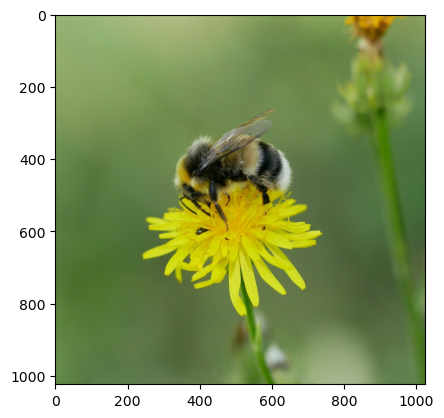

In [154]:
pytorch_predict(model_shufflenet, './bombus lucorum/bombus lucorum inaturalist 13.jpg')

In [155]:
print(class_names)

['bombus barbutellus', 'bombus bohemicus', 'bombus campestris', 'bombus cryptarum', 'bombus distinguendus', 'bombus hortorum', 'bombus hypnorum', 'bombus jonellus', 'bombus lapidarius', 'bombus lucorum', 'bombus magnus', 'bombus monticola', 'bombus muscorum', 'bombus pascuorum', 'bombus pratorum', 'bombus ruderarius', 'bombus rupestris', 'bombus sylvarum', 'bombus sylvestris', 'bombus terrestris', 'bombus vestalis']


In [156]:
lucorum_tensor = get_input_tensors(lucorum)
model_shufflenet.eval()
logits = model_shufflenet(lucorum_tensor)

In [157]:
print(logits)

tensor([[-4.4089,  4.9192, -2.2230, -2.3776,  3.7875, -5.6189, -3.6365, -2.0356,
         -0.0762,  0.9641, -1.4885, -6.8736,  0.1284, -2.2616,  1.8240, -5.0428,
         -4.2573, -0.9597,  2.2416, -6.9065, -5.1519, -6.6088, -6.5285, -7.0475,
         -7.3841, -7.9487, -7.0557, -7.7665, -7.5874, -6.7902, -7.4366, -7.7362,
         -7.4921, -8.3105, -8.4096, -8.0080, -7.4217, -7.0326, -7.7492, -7.8283,
         -7.1784, -7.6774, -6.8513, -6.6169, -7.2620, -7.3840, -7.1983, -6.7301,
         -7.0336, -7.2025, -6.3654, -7.7764, -7.3672, -7.4733, -7.5821, -7.5371,
         -7.8903, -7.8937, -6.5966, -7.2351, -7.5019, -7.4473, -7.8581, -7.5704,
         -7.9572, -7.0972, -7.8158, -5.8354, -7.7763, -7.5086, -7.9142, -7.4244,
         -7.4792, -7.5185, -7.3091, -7.5018, -7.1997, -7.3689, -7.1875, -7.5340,
         -7.0251, -7.9397, -7.3286, -7.4904, -7.2614, -7.0432, -7.4681, -6.9292,
         -7.1442, -7.4762, -7.2932, -6.8826, -6.6668, -7.3974, -7.2940, -7.4915,
         -7.0583, -7.3840, -

In [158]:
probs = F.softmax(logits, dim=1)
probs5 = probs.topk(5)
tuple((p,c, class_names[c]) for p, c in zip(probs5[0][0].detach().numpy(), probs5[1][0].detach().numpy()))

((0.6740039, 1, 'bombus bohemicus'),
 (0.21736164, 4, 'bombus distinguendus'),
 (0.04632182, 18, 'bombus sylvestris'),
 (0.030509474, 14, 'bombus pratorum'),
 (0.012912175, 9, 'bombus lucorum'))

In [159]:
def batch_predict_shufflenet(images):
    model_shufflenet.eval()
    batch = torch.stack(tuple(preprocess_transform(i) for i in images), dim=0)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model_shufflenet.to(device)
    batch = batch.to(device)
    
    logits = model_shufflenet(batch)
    probs = F.softmax(logits, dim=1)
    return probs.detach().cpu().numpy()

In [160]:
test_pred_shufflenet = batch_predict_shufflenet([image_transform(lucorum)])
class_label = test_pred_shufflenet.squeeze().argmax()
print(f'The top one predicted class label is {class_label}.')
print(f'The top one predicted class name is: {class_names[class_label]}.')

The top one predicted class label is 1.
The top one predicted class name is: bombus bohemicus.


In [161]:
explanation_shufflenet = explainer.explain_instance(np.array(image_transform(lucorum)), 
                                                    batch_predict_shufflenet,
                                                    top_labels=5, 
                                                    hide_color=0, 
                                                    num_samples=1000)

  0%|          | 0/1000 [00:00<?, ?it/s]

<br> </br>
- top 3 superpixels that are most positive towards the class

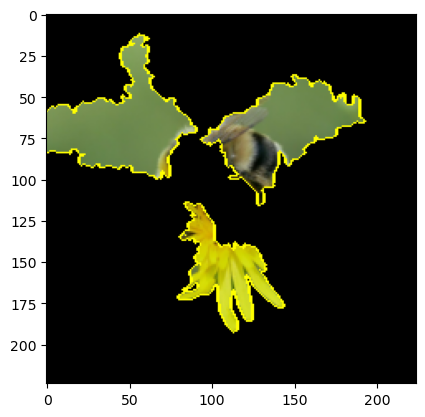

In [162]:
temp, mask = explanation_shufflenet.\
             get_image_and_mask(explanation_shufflenet.top_labels[0], 
                                positive_only=True, 
                                num_features=3, 
                                hide_rest=True)
plt.imshow(mark_boundaries(temp / 255.0, mask))

In [163]:
# temp, mask = explanation_shufflenet.\
#              get_image_and_mask(explanation_shufflenet.top_labels[0], 
#                                 positive_only=True, 
#                                 num_features=3, 
#                                 hide_rest=False)
# plt.imshow(mark_boundaries(temp / 255.0, mask))

<br> </br>
- pros and cons (pros in green, cons in red)

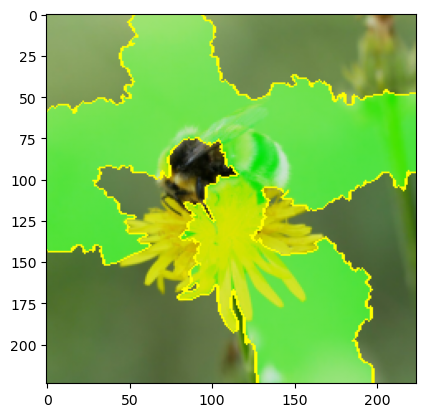

In [164]:
temp, mask = explanation_shufflenet.\
             get_image_and_mask(explanation_shufflenet.top_labels[0], 
                                positive_only=False, 
                                num_features=10, 
                                hide_rest=False)
plt.imshow(mark_boundaries(temp / 255.0, mask))

<br> </br>
- the pros and cons that have weight at least 0.1

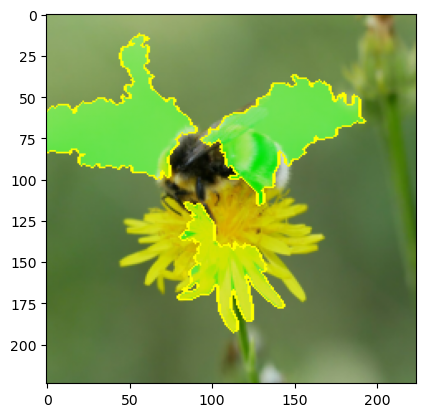

In [165]:
temp, mask = explanation_shufflenet.\
             get_image_and_mask(explanation_shufflenet.top_labels[0], 
                                positive_only=False, 
                                num_features=1000, 
                                hide_rest=False, 
                                min_weight=0.1)
plt.imshow(mark_boundaries(temp / 255.0, mask))

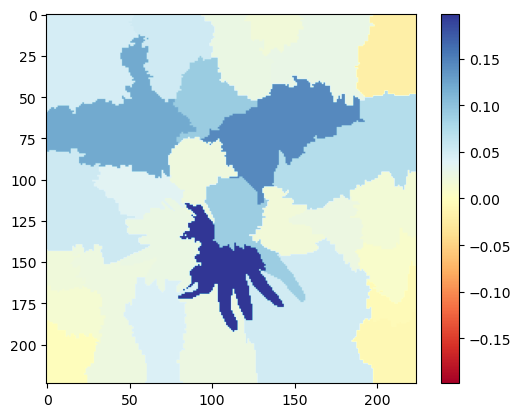

In [166]:
visualize_explanation_pytorch(explanation_shufflenet)

<br> </br>
## 4.2.4 GoogleNet
<br> </br>

In [167]:
os.chdir('/home/hduser/Desktop/final dataset testing/saved models')
# Create an instance of the GoogleNet model
model_googlenet = models.googlenet(weights='DEFAULT')
model_googlenet.dropout = nn.Dropout(p=0.4, inplace=False)
model_googlenet.fc = nn.Linear(in_features=1024, out_features=21, bias=True)

# Load the saved model weights
model_googlenet.load_state_dict(torch.load("model_googlenet.pth"))

# Set the model to evaluation mode
model_googlenet.eval()

GoogLeNet(
  (conv1): BasicConv2d(
    (conv): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
  (conv2): BasicConv2d(
    (conv): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv3): BasicConv2d(
    (conv): Conv2d(64, 192, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(192, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (maxpool2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=True)
  (inception3a): Inception(
    (branch1): BasicConv2d(
      (conv): Conv2d(192, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track

In [168]:
print_accuracy_pytorch(model_googlenet, test_loader, 'GoogleNet')

The overall test accuracy score of GoogleNet model:
 44.76%


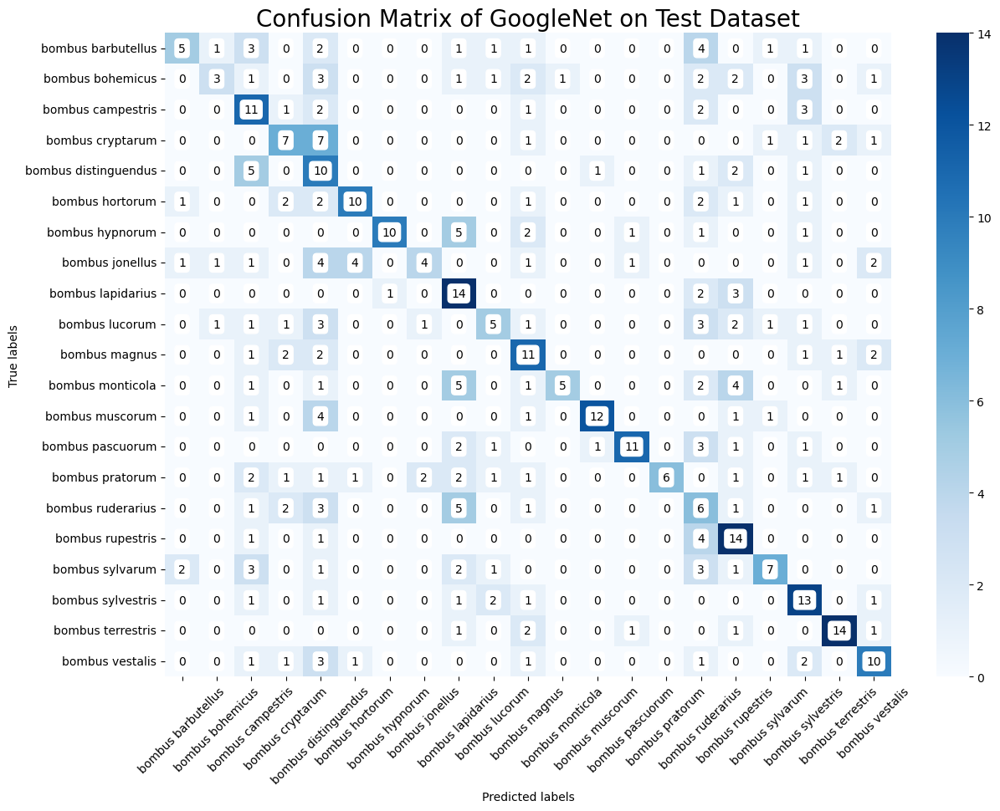

In [169]:
plot_confusion_matrix_test_pytorch(model_googlenet, test_loader, 'GoogleNet')

<br> </br>
<h1 style="font-size: 28px; text-align: center; color: purple"> LIME Evaluation </h1>
<br> </br>

In [170]:
os.chdir(test_data_dir)

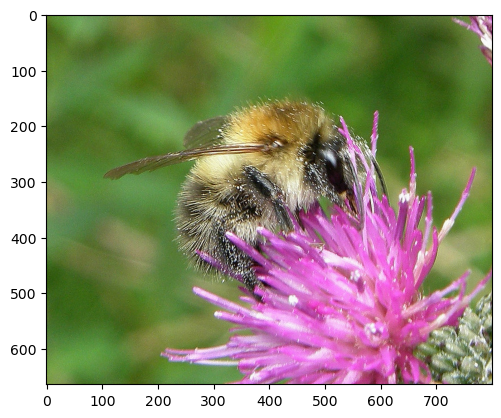

In [171]:
pascuorum = get_image('./bombus pascuorum/bombus pascuorum male 43.jpg')
plt.imshow(pascuorum)

Predcition 1 : bombus pascuorum , Score:  335.06046
Predcition 2 : bombus muscorum , Score:  1.0733746
Predcition 3 : bombus hypnorum , Score:  0.06869432
Predcition 4 : bombus distinguendus , Score:  0.054339845
Predcition 5 : bombus lucorum , Score:  0.0010463023
Predcition 6 : bombus campestris , Score:  0.0004418923
Predcition 7 : bombus rupestris , Score:  0.00035717268
Predcition 8 : bombus lapidarius , Score:  0.00030866446


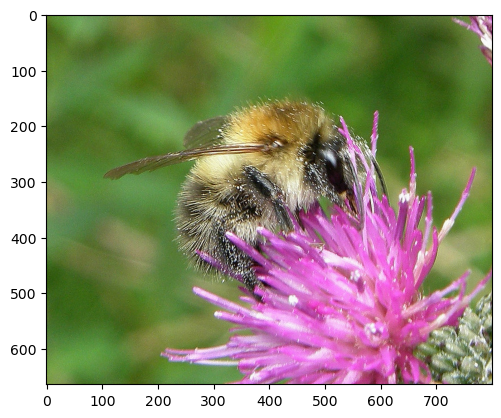

In [172]:
pytorch_predict(model_googlenet, './bombus pascuorum/bombus pascuorum male 43.jpg')

In [173]:
print(class_names)

['bombus barbutellus', 'bombus bohemicus', 'bombus campestris', 'bombus cryptarum', 'bombus distinguendus', 'bombus hortorum', 'bombus hypnorum', 'bombus jonellus', 'bombus lapidarius', 'bombus lucorum', 'bombus magnus', 'bombus monticola', 'bombus muscorum', 'bombus pascuorum', 'bombus pratorum', 'bombus ruderarius', 'bombus rupestris', 'bombus sylvarum', 'bombus sylvestris', 'bombus terrestris', 'bombus vestalis']


In [174]:
pascuorum_tensor = get_input_tensors(pascuorum)
model_googlenet.eval()
logits = model_googlenet(pascuorum_tensor)

In [175]:
print(logits)

tensor([[ -8.4422, -12.6163,  -5.8182, -18.1576,  -2.6420, -13.8417,  -3.3385,
         -15.6422,  -9.1701,  -8.9915, -14.0457,  -9.0791,   1.7333,   6.3622,
          -9.8361, -14.8497,  -6.8426,  -8.9051,  -9.3147, -14.8224, -11.6861]],
       grad_fn=<AddmmBackward0>)


In [176]:
probs = F.softmax(logits, dim=1)
probs5 = probs.topk(5)
tuple((p,c, class_names[c]) for p, c in zip(probs5[0][0].detach().numpy(), probs5[1][0].detach().numpy()))

((0.9901406, 13, 'bombus pascuorum'),
 (0.009668641, 12, 'bombus muscorum'),
 (0.00012168127, 4, 'bombus distinguendus'),
 (6.0633938e-05, 6, 'bombus hypnorum'),
 (5.0792482e-06, 2, 'bombus campestris'))

In [177]:
def batch_predict_googlenet(images):
    model_googlenet.eval()
    batch = torch.stack(tuple(preprocess_transform(i) for i in images), dim=0)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model_googlenet.to(device)
    batch = batch.to(device)
    
    logits = model_googlenet(batch)
    probs = F.softmax(logits, dim=1)
    return probs.detach().cpu().numpy()

In [178]:
test_pred_googlenet = batch_predict_googlenet([image_transform(pascuorum)])
class_label = test_pred_googlenet.squeeze().argmax()
print(f'The top one predicted class label is {class_label}.')
print(f'The top one predicted class name is: {class_names[class_label]}.')

The top one predicted class label is 13.
The top one predicted class name is: bombus pascuorum.


In [179]:
explanation_googlenet = explainer.explain_instance(np.array(image_transform(pascuorum)), 
                                                   batch_predict_googlenet,
                                                   top_labels=5, 
                                                   hide_color=0, 
                                                   num_samples=1000)

  0%|          | 0/1000 [00:00<?, ?it/s]

<br> </br>
- top 3 superpixels that are most positive towards the class

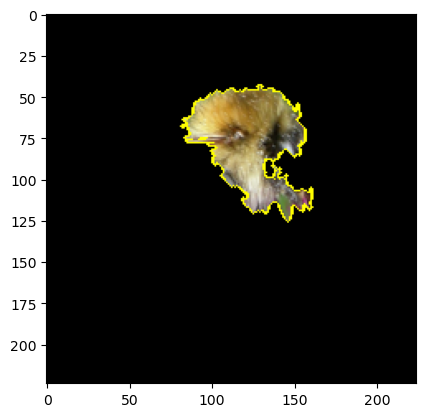

In [180]:
temp, mask = explanation_googlenet.\
             get_image_and_mask(explanation_googlenet.top_labels[0], 
                                positive_only=True, 
                                num_features=3, 
                                hide_rest=True)
plt.imshow(mark_boundaries(temp / 255.0, mask))

In [181]:
# temp, mask = explanation_googlenet.\
#              get_image_and_mask(explanation_googlenet.top_labels[0], 
#                                 positive_only=True, 
#                                 num_features=3, 
#                                 hide_rest=False)
# plt.imshow(mark_boundaries(temp / 255.0, mask))

<br> </br>
- pros and cons (pros in green, cons in red)

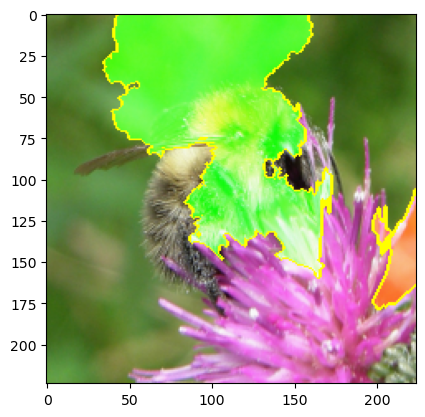

In [182]:
temp, mask = explanation_googlenet.\
             get_image_and_mask(explanation_googlenet.top_labels[0], 
                                positive_only=False, 
                                num_features=10, 
                                hide_rest=False)
plt.imshow(mark_boundaries(temp / 255.0, mask))

<br> </br>
- the pros and cons that have weight at least 0.1

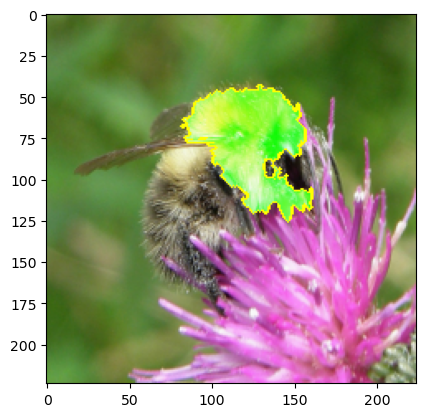

In [183]:
temp, mask = explanation_googlenet.\
             get_image_and_mask(explanation_googlenet.top_labels[0], 
                                positive_only=False, 
                                num_features=1000, 
                                hide_rest=False, 
                                min_weight=0.1)
plt.imshow(mark_boundaries(temp / 255.0, mask))

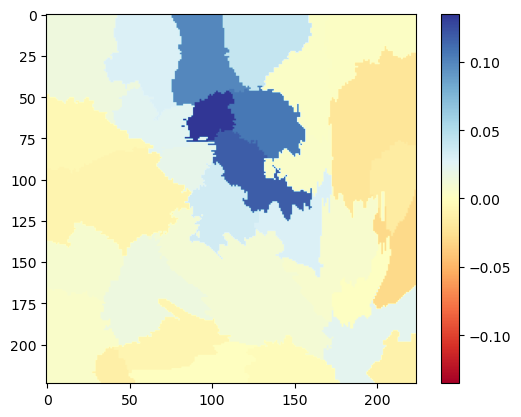

In [184]:
visualize_explanation_pytorch(explanation_googlenet)

<br> </br>
## 4.2.5 MNASNET1_0
<br> </br>

In [185]:
os.chdir('/home/hduser/Desktop/final dataset testing/saved models')
# Create an instance of the SqueezeNet model
model_mnasnet = models.mnasnet1_0(weights='DEFAULT')
model_mnasnet.avgpool = nn.AdaptiveAvgPool2d(output_size=(1, 1))
model_mnasnet.classifier[0] = nn.Dropout(p=0.4, inplace=False)
model_mnasnet.classifier[1] = nn.Linear(in_features=1280, out_features=21, bias=True)

# Load the saved model weights
model_mnasnet.load_state_dict(torch.load("model_mnasnet.pth"))

# Set the model to evaluation mode
model_mnasnet.eval()

MNASNet(
  (layers): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.00029999999999996696, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.00029999999999996696, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (7): BatchNorm2d(16, eps=1e-05, momentum=0.00029999999999996696, affine=True, track_running_stats=True)
    (8): Sequential(
      (0): _InvertedResidual(
        (layers): Sequential(
          (0): Conv2d(16, 48, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (1): BatchNorm2d(48, eps=1e-05, momentum=0.00029999999999996696, affine=True, track_running_stats=True)
          (2): ReLU(inplace=True)
          (3): Conv2d(48, 

In [186]:
print_accuracy_pytorch(model_mnasnet, test_loader, 'MNASNET1_0')

The overall test accuracy score of MNASNET1_0 model:
 45.00%


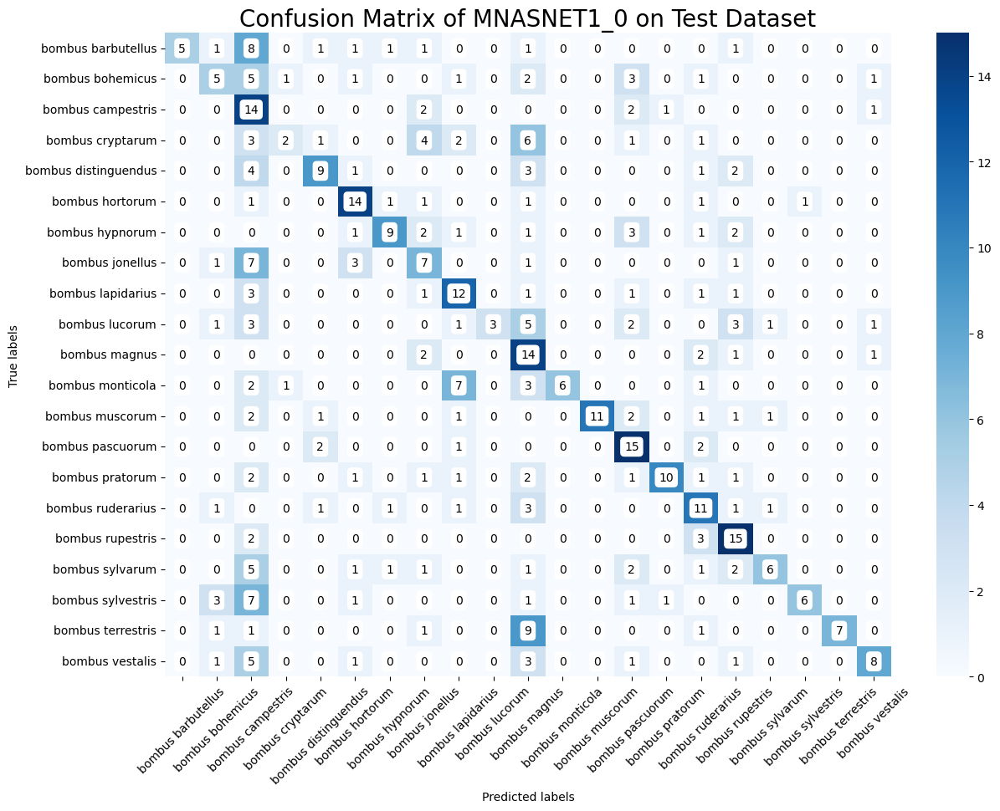

In [187]:
plot_confusion_matrix_test_pytorch(model_mnasnet, test_loader, 'MNASNET1_0')

<br> </br>
<h1 style="font-size: 28px; text-align: center; color: purple"> LIME Evaluation </h1>
<br> </br>

In [188]:
os.chdir(test_data_dir)

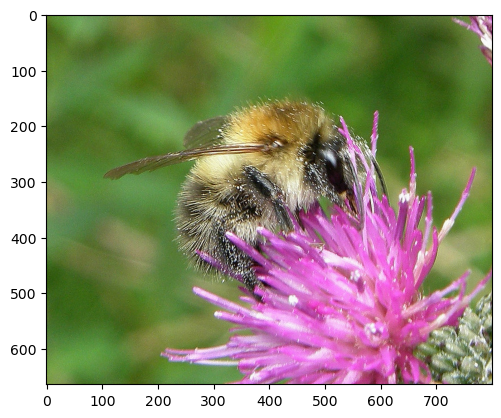

In [189]:
pascuorum = get_image('./bombus pascuorum/bombus pascuorum male 43.jpg')
plt.imshow(pascuorum)

Predcition 1 : bombus pascuorum , Score:  5921.579
Predcition 2 : bombus hypnorum , Score:  0.0247626
Predcition 3 : bombus distinguendus , Score:  0.002525458
Predcition 4 : bombus bohemicus , Score:  4.2355015e-05
Predcition 5 : bombus lucorum , Score:  2.8504124e-05
Predcition 6 : bombus campestris , Score:  2.3353394e-05
Predcition 7 : bombus muscorum , Score:  2.0837602e-05
Predcition 8 : bombus hortorum , Score:  1.7716582e-05


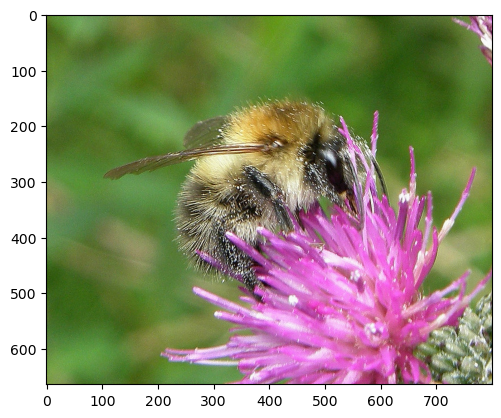

In [190]:
pytorch_predict(model_mnasnet, './bombus pascuorum/bombus pascuorum male 43.jpg')

In [191]:
print(class_names)

['bombus barbutellus', 'bombus bohemicus', 'bombus campestris', 'bombus cryptarum', 'bombus distinguendus', 'bombus hortorum', 'bombus hypnorum', 'bombus jonellus', 'bombus lapidarius', 'bombus lucorum', 'bombus magnus', 'bombus monticola', 'bombus muscorum', 'bombus pascuorum', 'bombus pratorum', 'bombus ruderarius', 'bombus rupestris', 'bombus sylvarum', 'bombus sylvestris', 'bombus terrestris', 'bombus vestalis']


In [192]:
pascuorum_tensor = get_input_tensors(pascuorum)
model_mnasnet.eval()
logits = model_mnasnet(pascuorum_tensor)

In [193]:
print(logits)

tensor([[-20.0455, -11.8333, -12.6110, -23.3073,  -0.8564, -10.2740,  -7.4610,
         -19.2258, -18.2751, -10.2272, -15.9712, -17.7188,  -3.6387,   8.2480,
         -20.4280, -31.9110, -17.9581, -12.5366, -18.1342, -20.6076, -11.1458]],
       grad_fn=<AddmmBackward0>)


In [194]:
probs = F.softmax(logits, dim=1)
probs5 = probs.topk(5)
tuple((p,c, class_names[c]) for p, c in zip(probs5[0][0].detach().numpy(), probs5[1][0].detach().numpy()))

((0.99988174, 13, 'bombus pascuorum'),
 (0.000111163616, 4, 'bombus distinguendus'),
 (6.8809745e-06, 12, 'bombus muscorum'),
 (1.5052753e-07, 6, 'bombus hypnorum'),
 (9.46871e-09, 9, 'bombus lucorum'))

In [195]:
def batch_predict_mnasnet(images):
    model_mnasnet.eval()
    batch = torch.stack(tuple(preprocess_transform(i) for i in images), dim=0)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model_mnasnet.to(device)
    batch = batch.to(device)
    
    logits = model_mnasnet(batch)
    probs = F.softmax(logits, dim=1)
    return probs.detach().cpu().numpy()

In [196]:
test_pred_mnasnet = batch_predict_mnasnet([image_transform(pascuorum)])
class_label = test_pred_mnasnet.squeeze().argmax()
print(f'The top one predicted class label is {class_label}.')
print(f'The top one predicted class name is: {class_names[class_label]}.')

The top one predicted class label is 13.
The top one predicted class name is: bombus pascuorum.


In [197]:
explanation_mnasnet = explainer.explain_instance(np.array(image_transform(pascuorum)), 
                                                 batch_predict_mnasnet,
                                                 top_labels=5, 
                                                 hide_color=0, 
                                                 num_samples=1000)

  0%|          | 0/1000 [00:00<?, ?it/s]

<br> </br>
- top 3 superpixels that are most positive towards the class

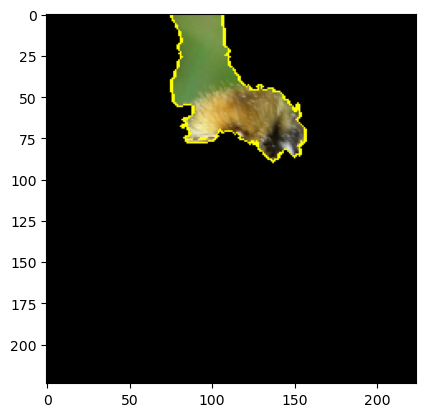

In [198]:
temp, mask = explanation_mnasnet.\
             get_image_and_mask(explanation_mnasnet.top_labels[0], 
                                positive_only=True, 
                                num_features=3, 
                                hide_rest=True)
plt.imshow(mark_boundaries(temp / 255.0, mask))

In [199]:
# temp, mask = explanation_mnasnet.\
#              get_image_and_mask(explanation_mnasnet.top_labels[0], 
#                                 positive_only=True, 
#                                 num_features=3, 
#                                 hide_rest=False)
# plt.imshow(mark_boundaries(temp / 255.0, mask))

<br> </br>
- pros and cons (pros in green, cons in red)

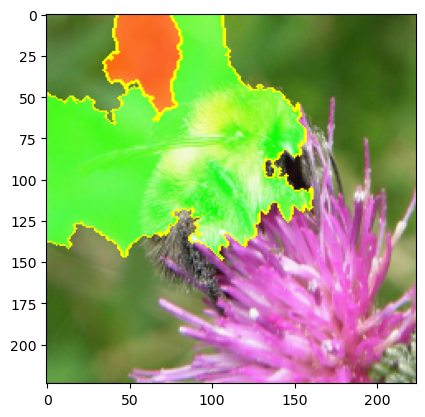

In [200]:
temp, mask = explanation_mnasnet.\
             get_image_and_mask(explanation_mnasnet.top_labels[0], 
                                positive_only=False, 
                                num_features=10, 
                                hide_rest=False)
plt.imshow(mark_boundaries(temp / 255.0, mask))

<br> </br>
- the pros and cons that have weight at least 0.1

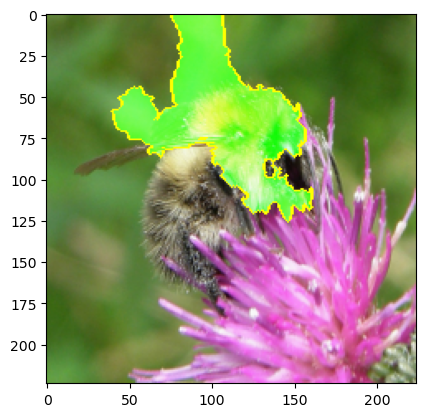

In [201]:
temp, mask = explanation_mnasnet.\
             get_image_and_mask(explanation_mnasnet.top_labels[0], 
                                positive_only=False, 
                                num_features=1000, 
                                hide_rest=False, 
                                min_weight=0.1)
plt.imshow(mark_boundaries(temp / 255.0, mask))

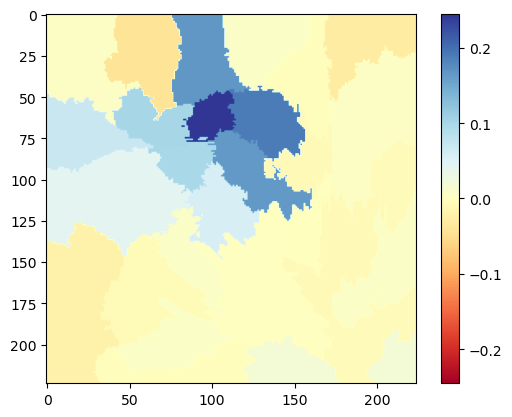

In [202]:
visualize_explanation_pytorch(explanation_mnasnet)